In [1]:
import pandas as pd
import numpy as np
import pickle, IPython,soundfile, librosa
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [2]:
# rawDf = pd.read_csv('./results_re_new.csv')
with open('./results_model_20221226.pickle','br') as f : 
    rawDf = pickle.load(f)
rawDf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51507 entries, 0 to 51506
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   fileName     51507 non-null  object 
 1   recon_error  51507 non-null  float32
 2   t_v          51507 non-null  object 
 3   lv           51507 non-null  object 
dtypes: float32(1), object(3)
memory usage: 1.4+ MB


In [3]:
labels = pd.read_csv('sound_labeling_1s.csv')
labels.columns = ['fileName', 'isInfected']
labels.isInfected.value_counts()

0    6224
1     616
Name: isInfected, dtype: int64

In [4]:
rawDf.fileName.iloc[-1]
labels.fileName.iloc[-1]

'FA0004_GW01_H01_0203_20211109003145_farm_mic_snd_f9ff427d41dc_07.jpg'

'FA0004_GW01_H01_0203_20211117081644_farm_mic_snd_50cbcc6d48e7_59.jpg'

In [5]:
rawDf = pd.merge(rawDf,labels,how="left", left_on='fileName', right_on = 'fileName')
rawDf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51507 entries, 0 to 51506
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   fileName     51507 non-null  object 
 1   recon_error  51507 non-null  float32
 2   t_v          51507 non-null  object 
 3   lv           51507 non-null  object 
 4   isInfected   4366 non-null   float64
dtypes: float32(1), float64(1), object(3)
memory usage: 2.2+ MB


In [6]:
rawDf.isnull().sum()

rawDf.isInfected.fillna(0, inplace=True)

rawDf.isnull().sum()

fileName           0
recon_error        0
t_v                0
lv                 0
isInfected     47141
dtype: int64

fileName       0
recon_error    0
t_v            0
lv             0
isInfected     0
dtype: int64

In [7]:
rawDf['createTime'] = [x.split('_')[4] for x in rawDf.fileName]
rawDf['createTime'] = pd.to_datetime(rawDf.createTime)
rawDf

,fileName,recon_error,t_v,lv,isInfected,createTime
0,FA0004_GW01_H01_0203_20211109131146_farm_mic_s...,9.586159,"[[-0.8614036, 0.21335429, 0.28881118, 0.359238]]","[0.48686913, 0.7065748, 0.4397973]",0.0,2021-11-09 13:11:46
1,FA0004_GW01_H01_0203_20211109151152_farm_mic_s...,9.365865,"[[-0.8645733, 0.2411249, 0.30799448, 0.31545392]]","[0.5021628, 0.5182144, 0.3891205]",0.0,2021-11-09 15:11:52
2,FA0004_GW01_H01_0202_20211109003645_farm_mic_s...,5.237098,"[[-0.86467886, 0.24359867, 0.3027971, 0.318283...","[0.29517528, 0.60613424, 0.6213812]",0.0,2021-11-09 00:36:45
3,FA0004_GW01_H01_0203_20211109050147_farm_mic_s...,9.628260,"[[-0.8645696, 0.24105076, 0.30815327, 0.3153656]]","[0.31107518, 0.63924104, 0.26379755]",0.0,2021-11-09 05:01:47
4,FA0004_GW01_H01_0203_20211109193146_farm_mic_s...,5.734961,"[[-0.8639408, 0.23157367, 0.3119526, 0.32041463]]","[0.65919983, 0.43672514, 0.5307697]",0.0,2021-11-09 19:31:46
...,...,...,...,...,...,...
51502,FA0004_GW01_H01_0203_20211109133650_farm_mic_s...,7.390535,"[[-0.8643278, 0.23721048, 0.30964708, 0.3174702]]","[0.51251924, 0.6859086, 0.56872505]",0.0,2021-11-09 13:36:50
51503,FA0004_GW01_H01_0202_20211108204144_farm_mic_s...,15.072239,"[[-0.86457103, 0.24118967, 0.30709416, 0.31628...","[0.5396076, 0.5389957, 0.68882257]",0.0,2021-11-08 20:41:44
51504,FA0004_GW01_H01_0202_20211108140144_farm_mic_s...,3.453888,"[[-0.86206156, 0.22602756, 0.2762333, 0.3598007]]","[0.40057242, 0.4303145, 0.519126]",0.0,2021-11-08 14:01:44
51505,FA0004_GW01_H01_0203_20211109212148_farm_mic_s...,4.231093,"[[-0.8411054, 0.08590804, 0.37759867, 0.377598...","[0.54322314, 0.46285355, 0.5627309]",0.0,2021-11-09 21:21:48


## plot by recon_error

<Figure size 1000x700 with 0 Axes>

abnormal : 341


<AxesSubplot: xlabel='recon_error', ylabel='Percent'>

Text(0.5, 1.0, 'abnormal')

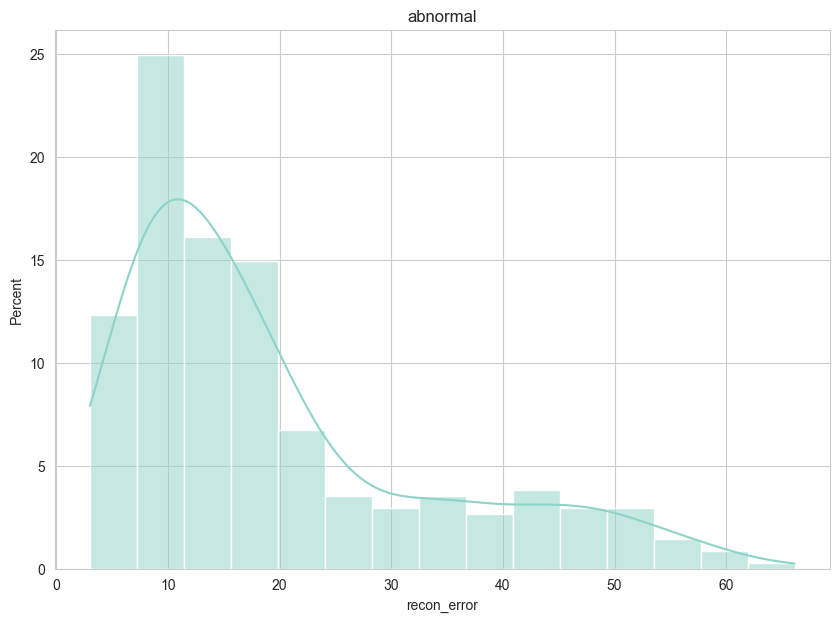

<Figure size 1000x700 with 0 Axes>

normal : 51166


<AxesSubplot: xlabel='recon_error', ylabel='Percent'>

Text(0.5, 1.0, 'normal')

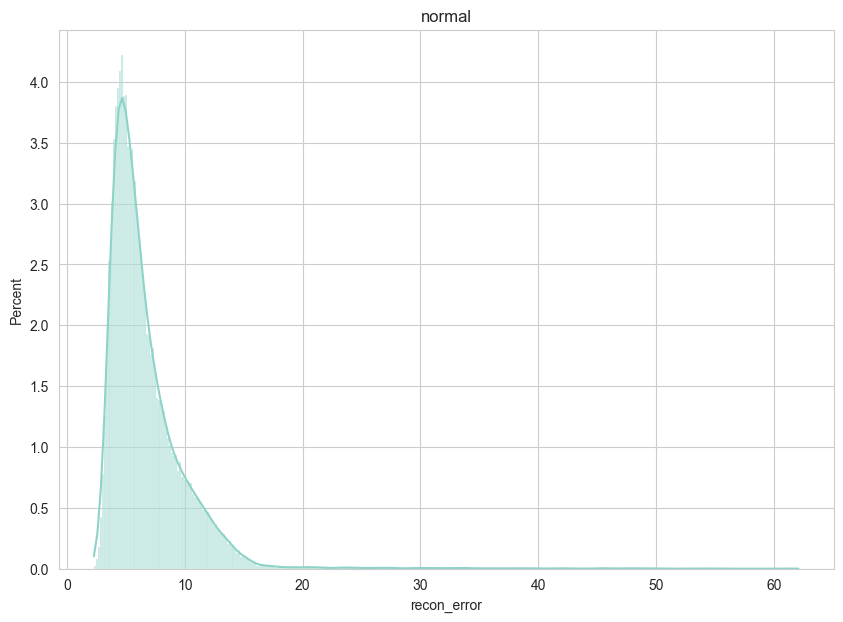

<Figure size 1000x700 with 0 Axes>

Text(0.5, 1.0, 'normal')

<Figure size 1000x700 with 0 Axes>

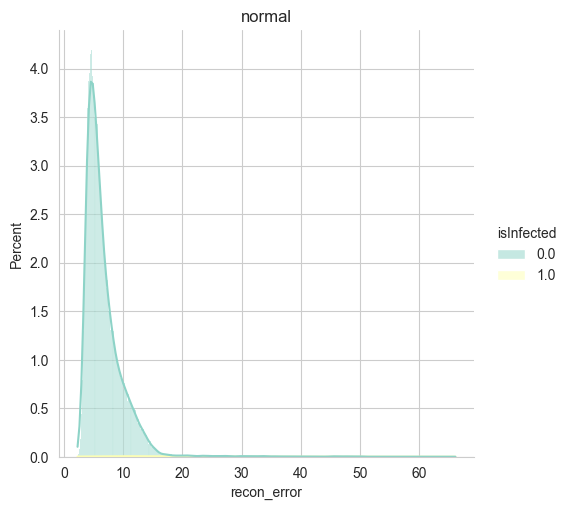

In [8]:

sns.set_style('whitegrid')

plt.figure(figsize=(10,7))
print(f"abnormal : {len(rawDf[rawDf.isInfected == 1.0]['recon_error'])}")
sns.histplot(data=rawDf[rawDf.isInfected == 1.0]['recon_error'], kde=True, stat='percent')
plt.title("abnormal")
plt.show()

plt.figure(figsize=(10,7))
print(f"normal : {len(rawDf[rawDf.isInfected == 0.0]['recon_error'])}")
sns.histplot(data=rawDf[rawDf.isInfected == 0.0]['recon_error'], kde=True, stat='percent')
plt.title("normal")
plt.show()


plt.figure(figsize=(10,7))
sns.displot(data=rawDf, x = 'recon_error', kde=True, hue='isInfected', stat='percent')
plt.title("normal")
plt.show()


count :             fileName  recon_error    t_v     lv  createTime
isInfected                                                 
0.0            51166        51166  51166  51166       51166
1.0              341          341    341    341         341


<Figure size 1000x700 with 0 Axes>

<AxesSubplot: xlabel='createTime', ylabel='recon_error'>

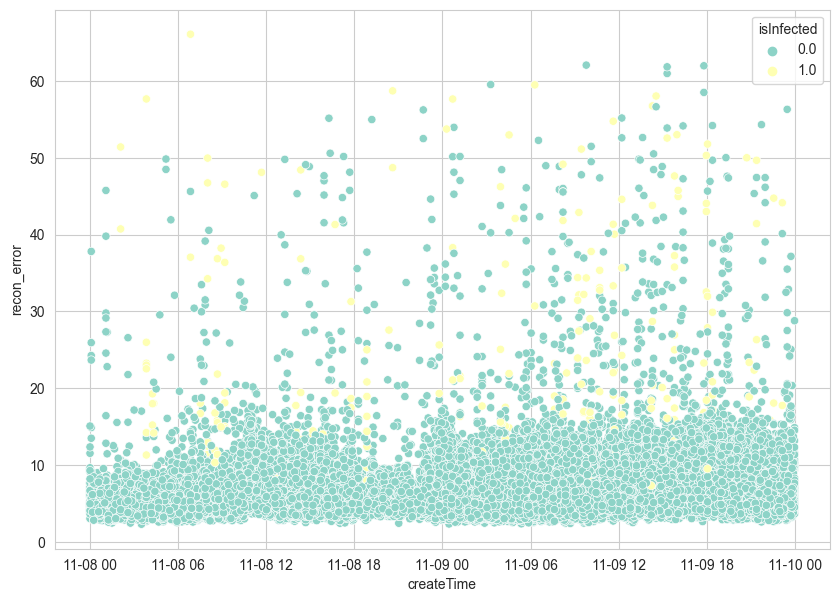

<Figure size 1000x700 with 0 Axes>

<AxesSubplot: xlabel='createTime', ylabel='recon_error'>

Text(0.5, 1.0, 'inFected')

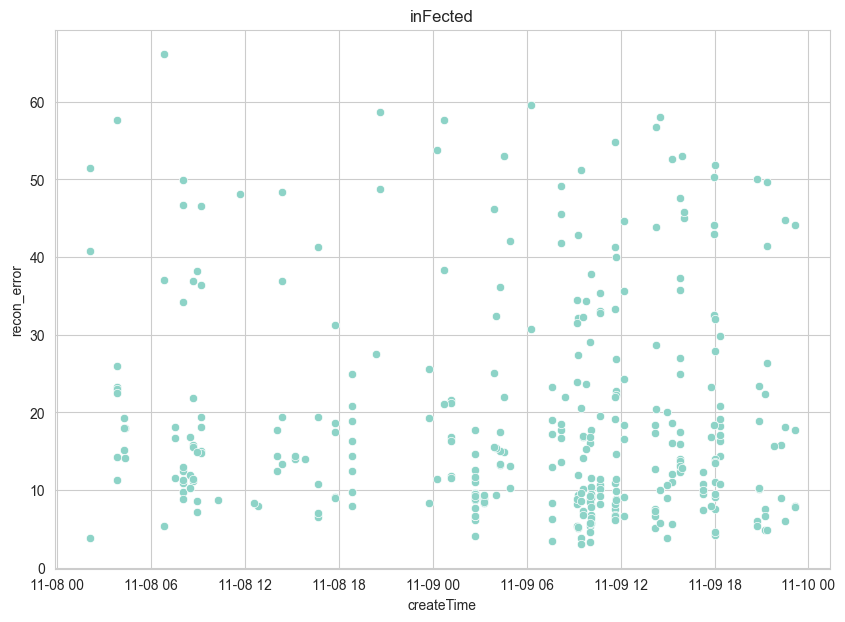

In [9]:
sns.set_style('whitegrid')

plot_df = rawDf # [(rawDf.recon_error >= 10) & (rawDf.recon_error< 45)]
print(f"count : {plot_df.groupby('isInfected').agg('count')}")
plt.figure(figsize=(10,7))
sns.scatterplot(data=plot_df, x='createTime', y='recon_error', hue='isInfected')
plt.show()

plt.figure(figsize=(10,7))
sns.scatterplot(data=plot_df[plot_df.isInfected == 1.0], x='createTime', y='recon_error')
plt.title("inFected")
plt.show()


In [10]:
fileListAllStrage = rawDf[(rawDf.recon_error >= 20.)]['fileName'].to_list()
fileListAbnormal = rawDf[(rawDf.recon_error >= 10.) & (rawDf.isInfected == 1.0)]['fileName'].to_list()
print(f"Strange All :{len(fileListAllStrage)}/{len(rawDf)}")
print(f"Abnormal Only : {len(fileListAbnormal)}/{len(rawDf[(rawDf.isInfected == 1.0)])}")

Strange All :544/51507
Abnormal Only : 238/341


### image abnormal

253

FA0004_GW01_H01_0202_20211108020645_farm_mic_snd_dd483d8e4240_25.jpg : [84.281494]


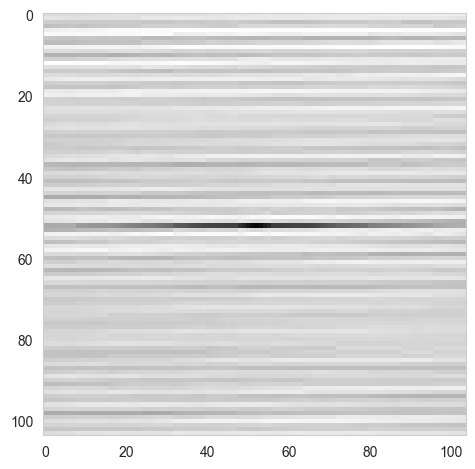

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_02.jpg : [63.43656]


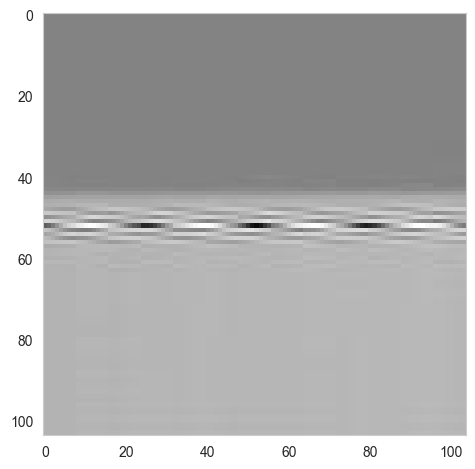

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_04.jpg : [72.12708]


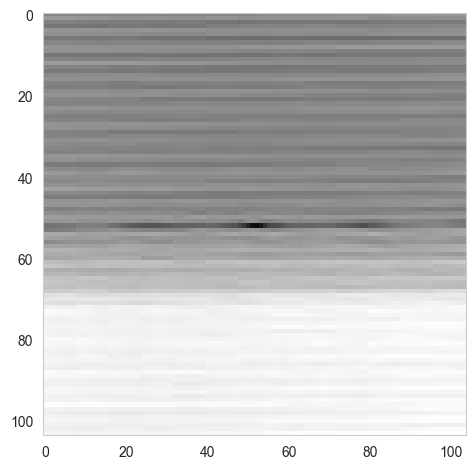

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_22.jpg : [72.72584]


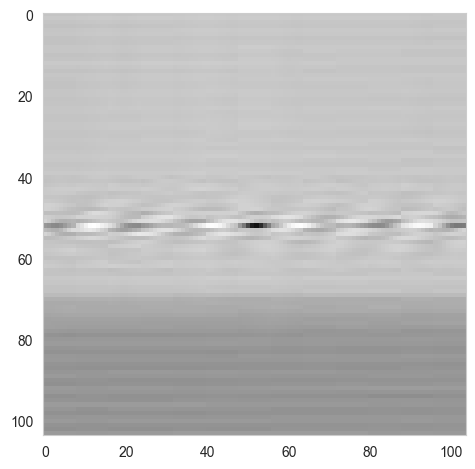

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_47.jpg : [70.754814]


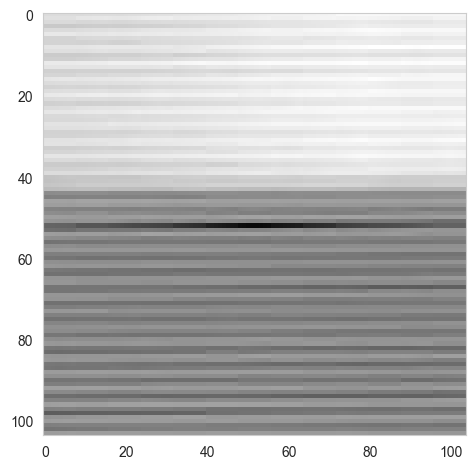

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_49.jpg : [73.79816]


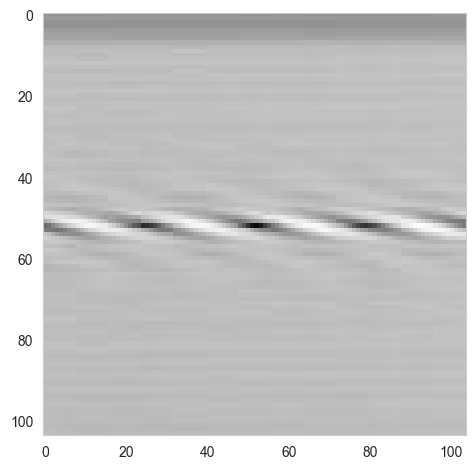

FA0004_GW01_H01_0202_20211108041643_farm_mic_snd_27bc75ef41e7_29.jpg : [74.61978]


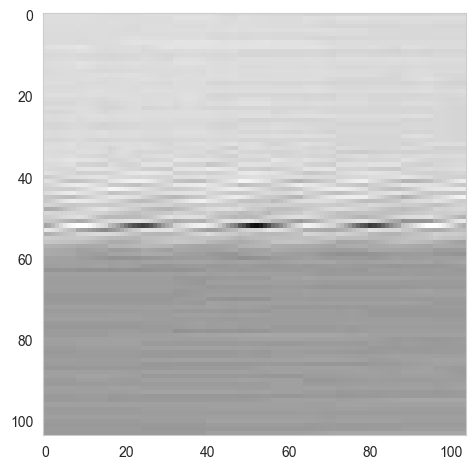

FA0004_GW01_H01_0202_20211108041643_farm_mic_snd_27bc75ef41e7_54.jpg : [66.247734]


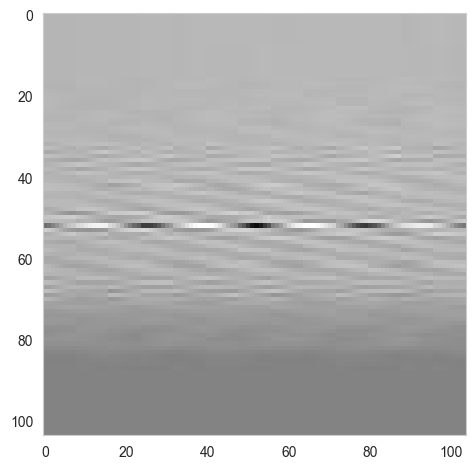

FA0004_GW01_H01_0202_20211108041643_farm_mic_snd_27bc75ef41e7_55.jpg : [67.803925]


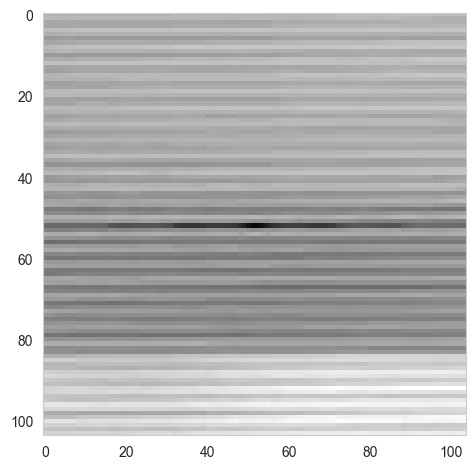

FA0004_GW01_H01_0202_20211108042146_farm_mic_snd_c7a25c584a92_02.jpg : [73.923195]


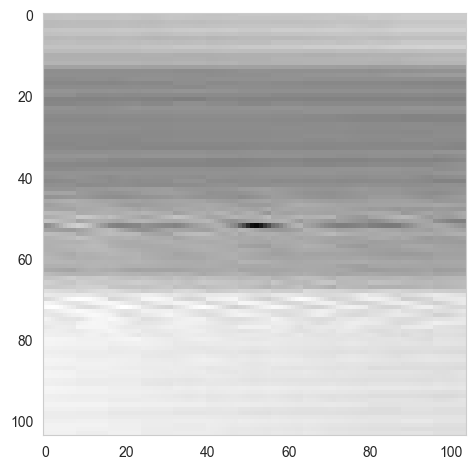

FA0004_GW01_H01_0202_20211108042146_farm_mic_snd_c7a25c584a92_25.jpg : [69.957855]


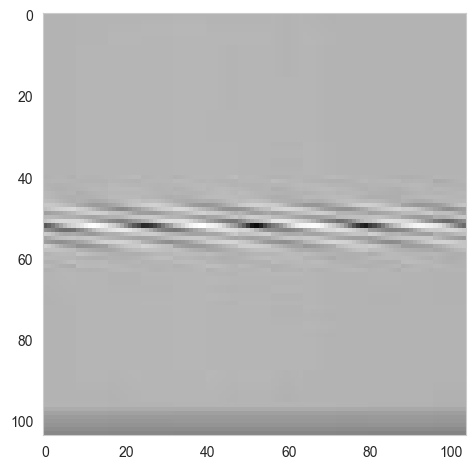

FA0004_GW01_H01_0202_20211108065144_farm_mic_snd_5473959d401d_19.jpg : [84.431915]


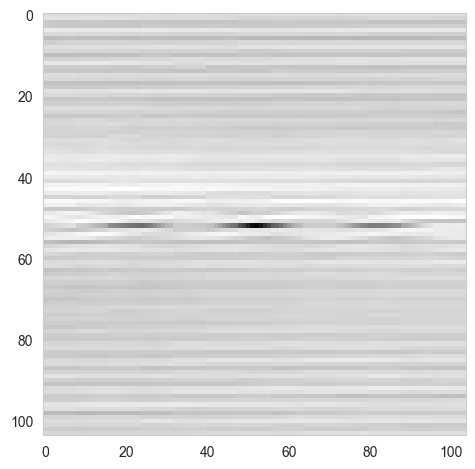

FA0004_GW01_H01_0202_20211108073143_farm_mic_snd_b1c43cd04cc0_08.jpg : [74.2825]


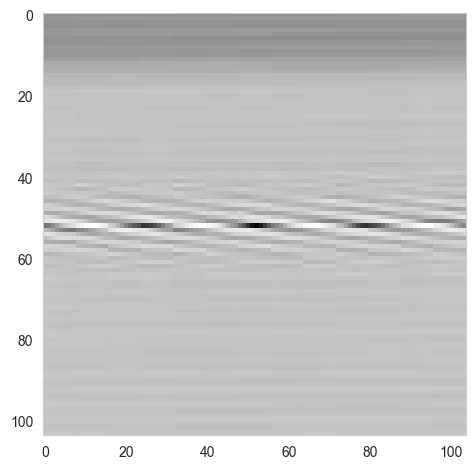

FA0004_GW01_H01_0202_20211108073143_farm_mic_snd_b1c43cd04cc0_10.jpg : [71.16914]


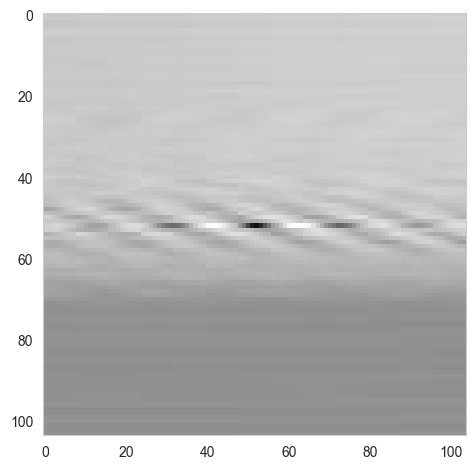

FA0004_GW01_H01_0202_20211108073143_farm_mic_snd_b1c43cd04cc0_36.jpg : [71.120575]


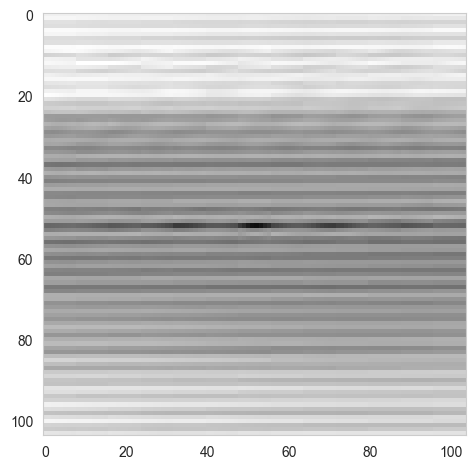

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_08.jpg : [72.49269]


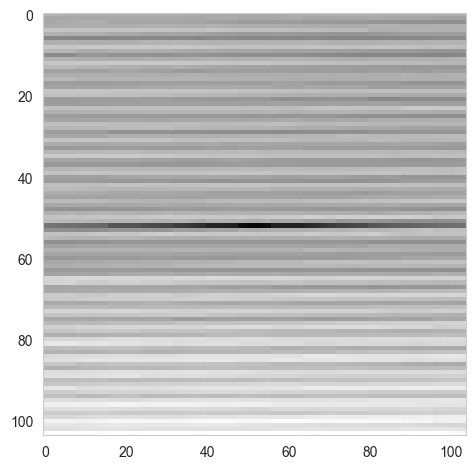

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_19.jpg : [72.282684]


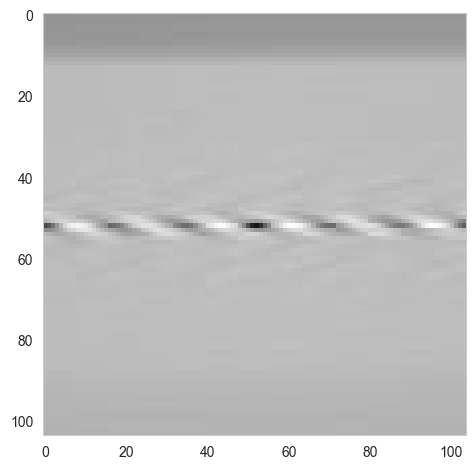

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_20.jpg : [77.69082]


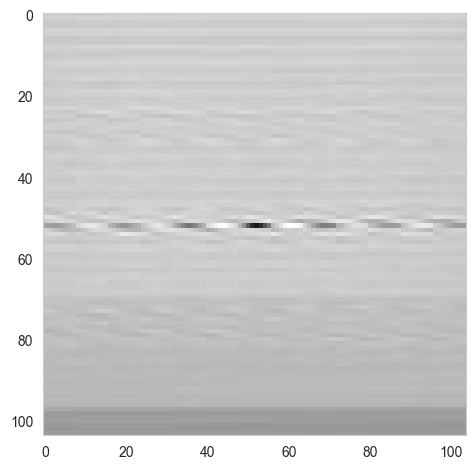

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_31.jpg : [73.11577]


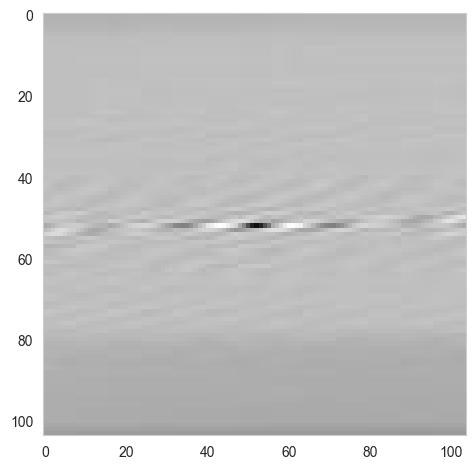

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_45.jpg : [77.531105]


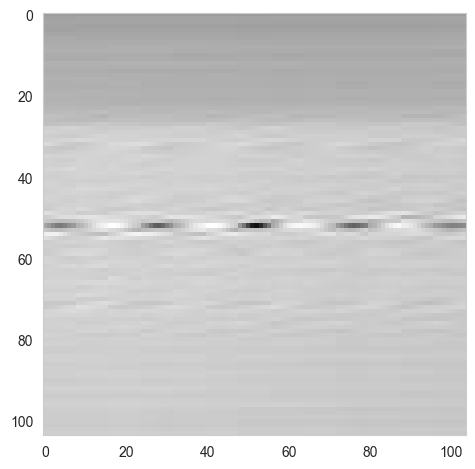

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_47.jpg : [75.04347]


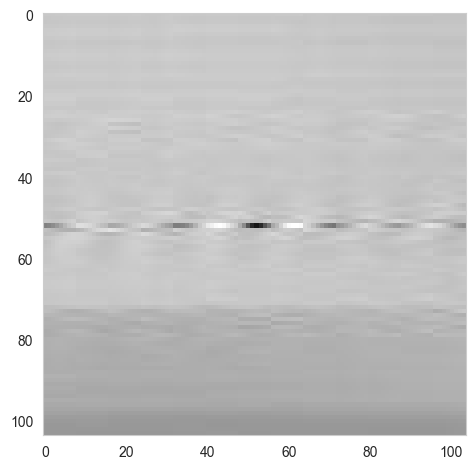

FA0004_GW01_H01_0202_20211108083145_farm_mic_snd_04253a954e88_27.jpg : [76.13537]


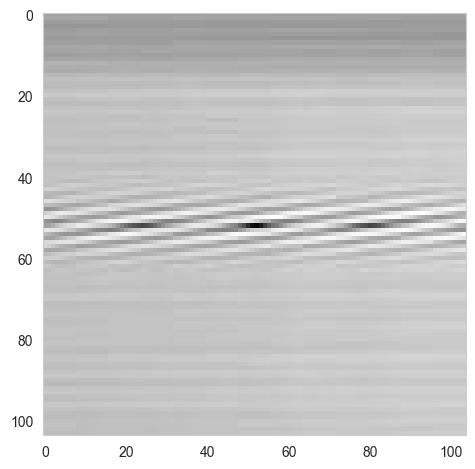

FA0004_GW01_H01_0202_20211108083145_farm_mic_snd_04253a954e88_44.jpg : [73.637085]


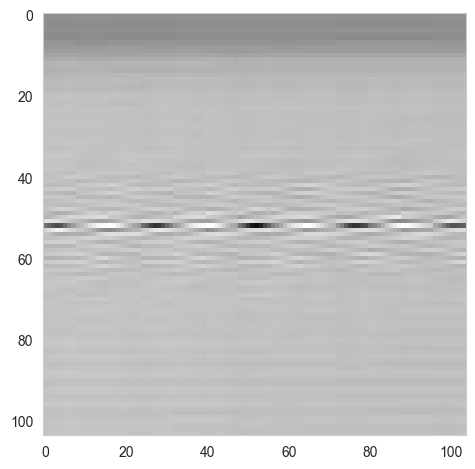

FA0004_GW01_H01_0202_20211108083145_farm_mic_snd_04253a954e88_54.jpg : [69.30818]


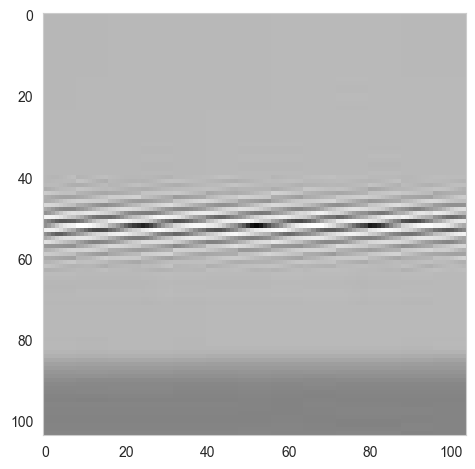

FA0004_GW01_H01_0202_20211108084144_farm_mic_snd_733c10ac4bd7_21.jpg : [76.82475]


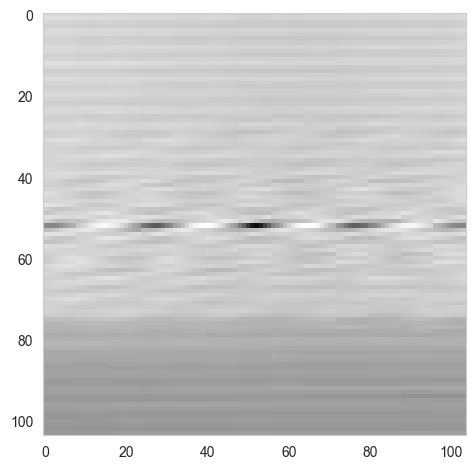

FA0004_GW01_H01_0202_20211108084144_farm_mic_snd_733c10ac4bd7_28.jpg : [75.37998]


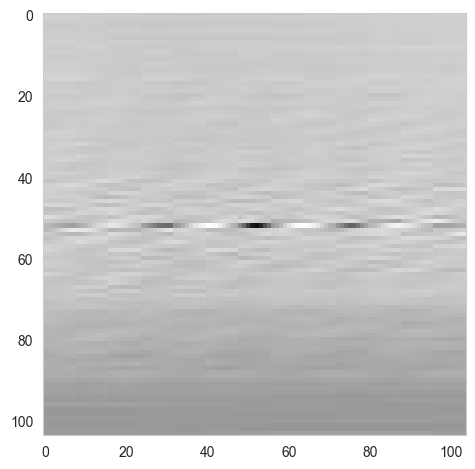

FA0004_GW01_H01_0202_20211108084144_farm_mic_snd_733c10ac4bd7_38.jpg : [70.89901]


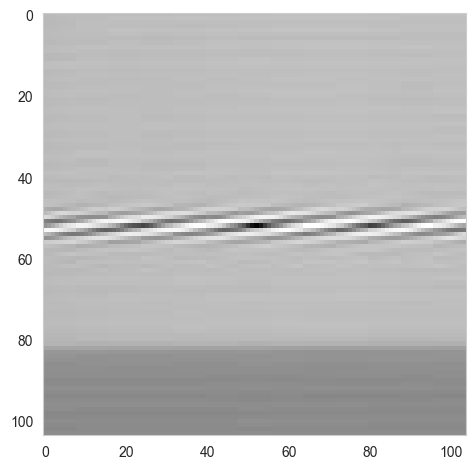

FA0004_GW01_H01_0202_20211108084144_farm_mic_snd_733c10ac4bd7_53.jpg : [73.07741]


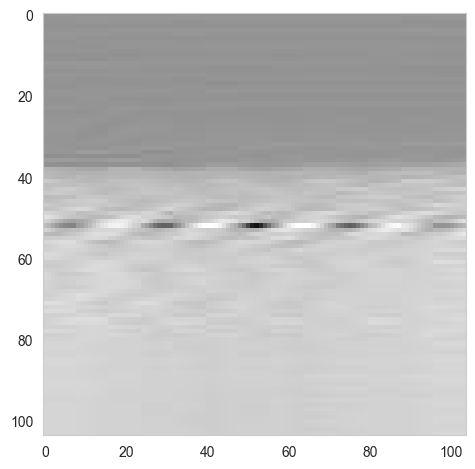

FA0004_GW01_H01_0202_20211108085644_farm_mic_snd_c0f28f0f452d_20.jpg : [84.63062]


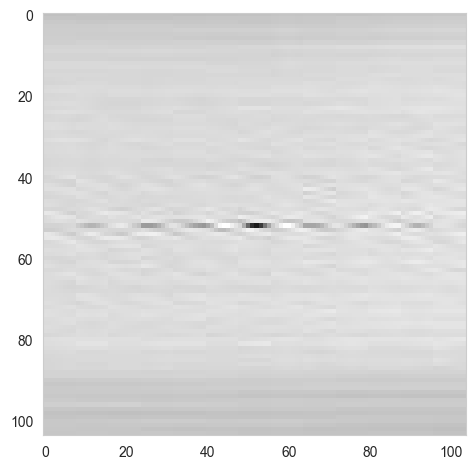

FA0004_GW01_H01_0202_20211108085644_farm_mic_snd_c0f28f0f452d_37.jpg : [76.9154]


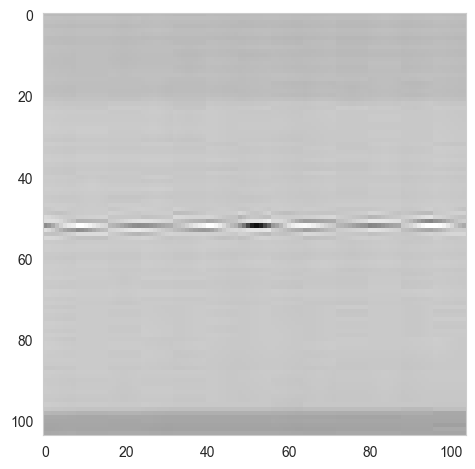

FA0004_GW01_H01_0202_20211108085644_farm_mic_snd_c0f28f0f452d_41.jpg : [71.30164]


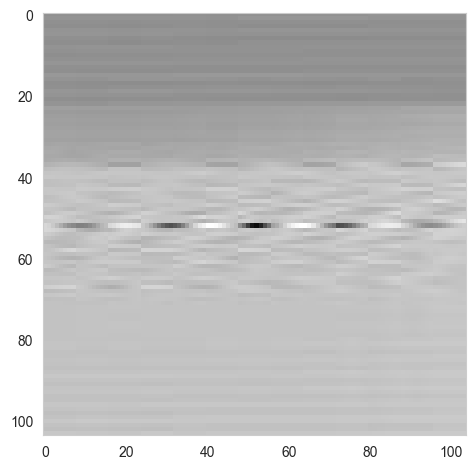

FA0004_GW01_H01_0202_20211108085644_farm_mic_snd_c0f28f0f452d_53.jpg : [68.87567]


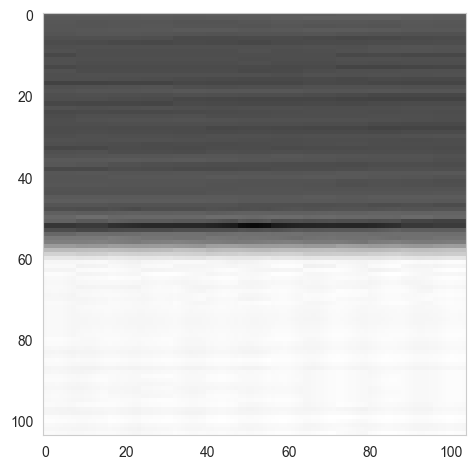

FA0004_GW01_H01_0202_20211108091144_farm_mic_snd_f7a3bcf049f0_01.jpg : [73.31739]


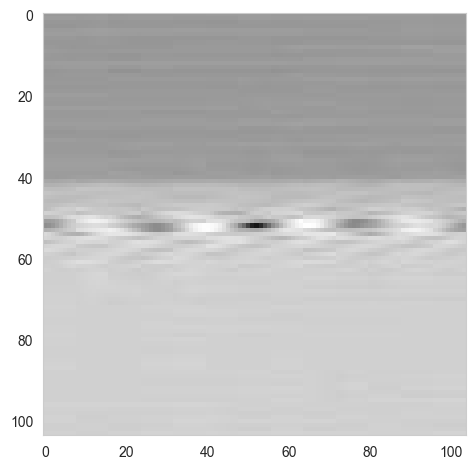

FA0004_GW01_H01_0202_20211108091144_farm_mic_snd_f7a3bcf049f0_13.jpg : [65.66537]


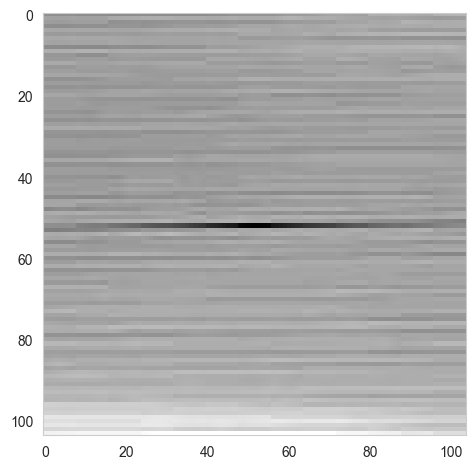

FA0004_GW01_H01_0202_20211108091144_farm_mic_snd_f7a3bcf049f0_19.jpg : [66.44483]


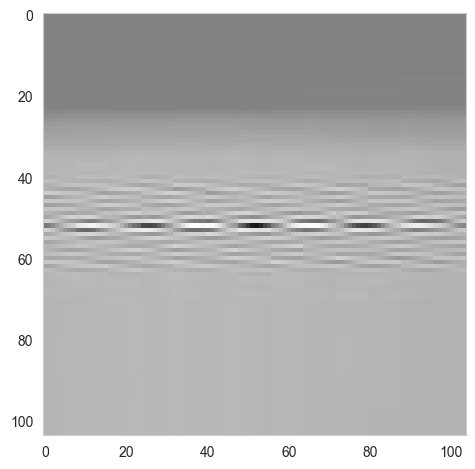

FA0004_GW01_H01_0202_20211108091144_farm_mic_snd_f7a3bcf049f0_45.jpg : [70.853516]


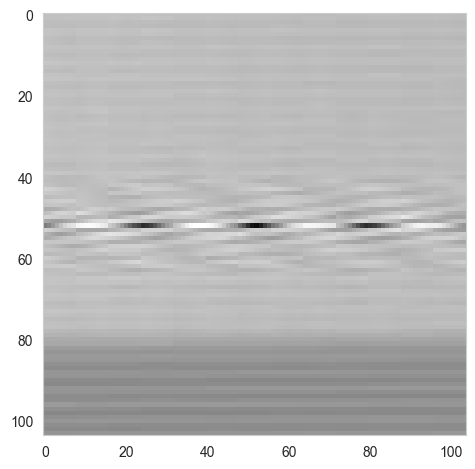

FA0004_GW01_H01_0202_20211108101644_farm_mic_snd_c5f6f16045c1_25.jpg : [78.03606]


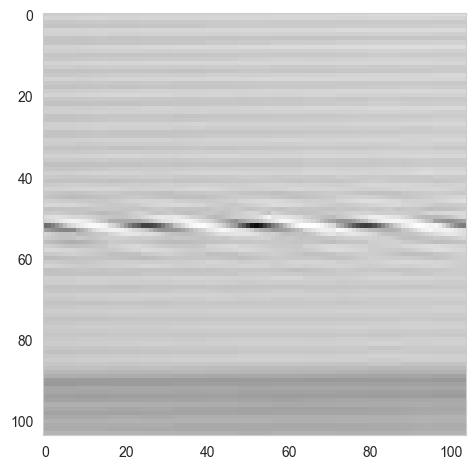

FA0004_GW01_H01_0202_20211108123645_farm_mic_snd_5b150ade4abd_01.jpg : [77.84028]


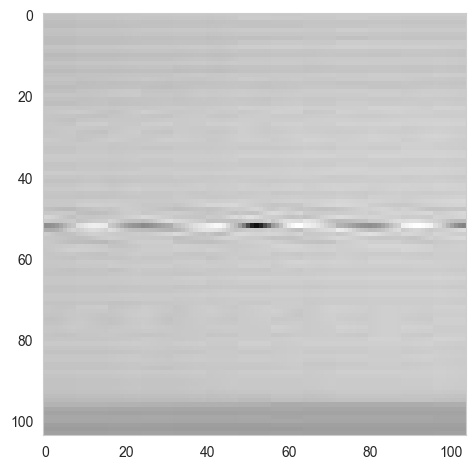

FA0004_GW01_H01_0202_20211108125145_farm_mic_snd_f3ad7c50499e_19.jpg : [78.066216]


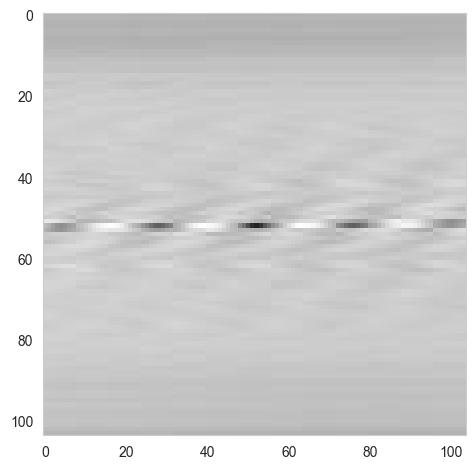

FA0004_GW01_H01_0202_20211108140144_farm_mic_snd_ec93221e43d7_02.jpg : [68.57499]


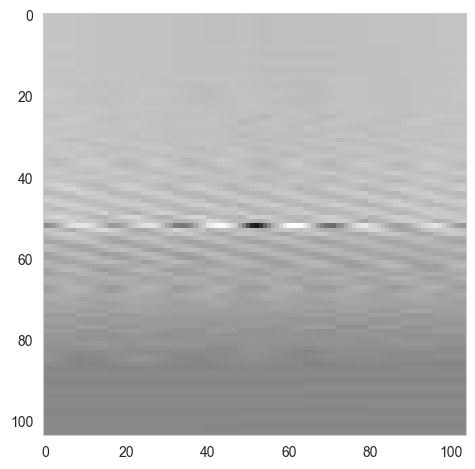

FA0004_GW01_H01_0202_20211108140144_farm_mic_snd_ec93221e43d7_39.jpg : [71.62392]


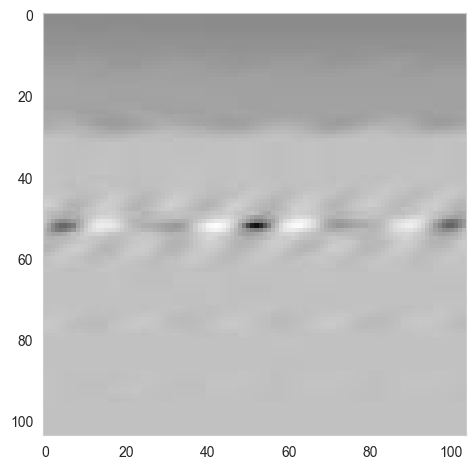

FA0004_GW01_H01_0202_20211108140144_farm_mic_snd_ec93221e43d7_40.jpg : [82.13248]


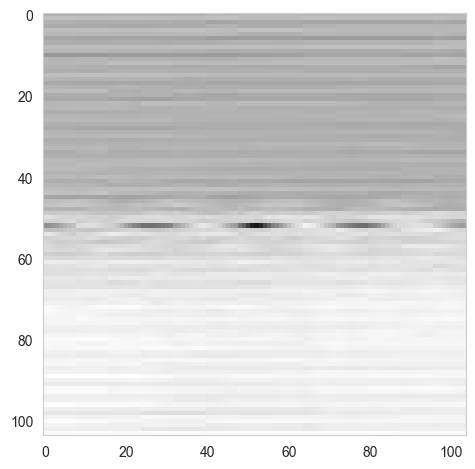

FA0004_GW01_H01_0202_20211108142145_farm_mic_snd_a263dc2048a5_31.jpg : [71.11191]


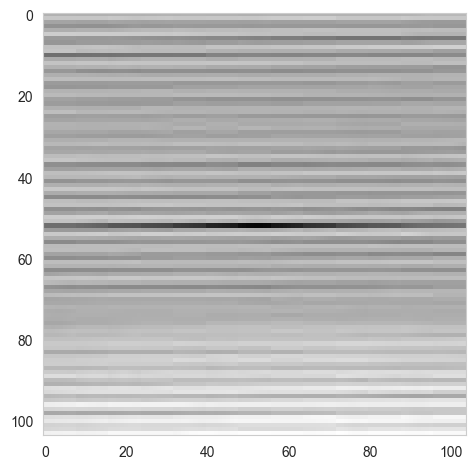

FA0004_GW01_H01_0202_20211108142145_farm_mic_snd_a263dc2048a5_52.jpg : [67.01333]


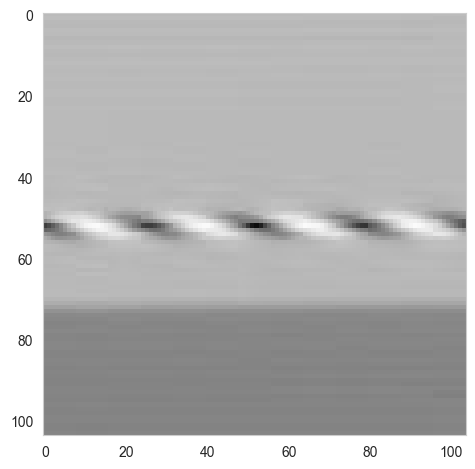

FA0004_GW01_H01_0202_20211108151145_farm_mic_snd_2d2e0a5543e5_27.jpg : [70.45862]


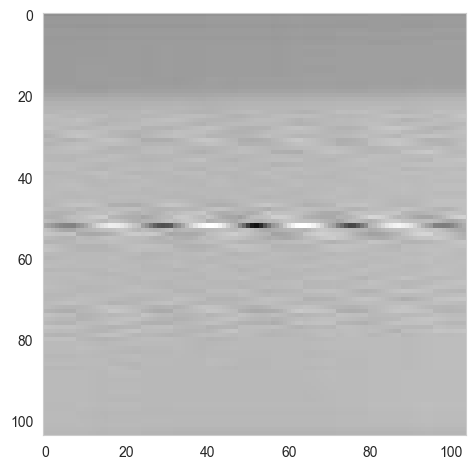

FA0004_GW01_H01_0202_20211108151145_farm_mic_snd_2d2e0a5543e5_35.jpg : [70.28566]


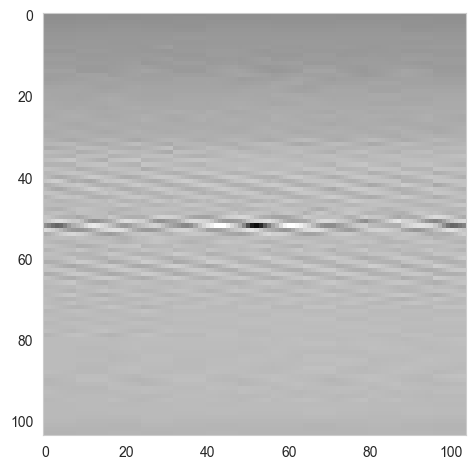

FA0004_GW01_H01_0202_20211108155145_farm_mic_snd_a7277a444836_02.jpg : [72.1121]


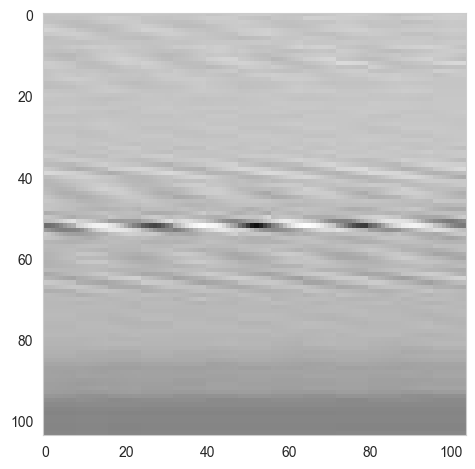

FA0004_GW01_H01_0202_20211108164145_farm_mic_snd_744caeef4f80_10.jpg : [79.22871]


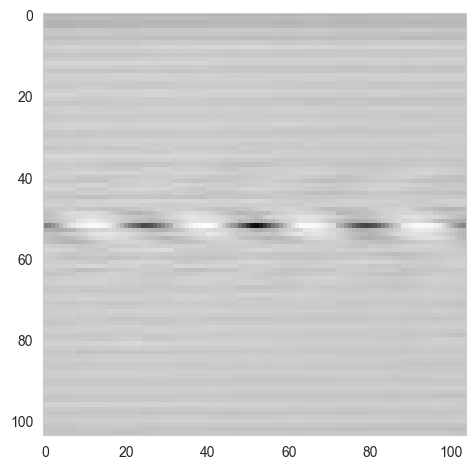

FA0004_GW01_H01_0202_20211108164145_farm_mic_snd_744caeef4f80_14.jpg : [74.12803]


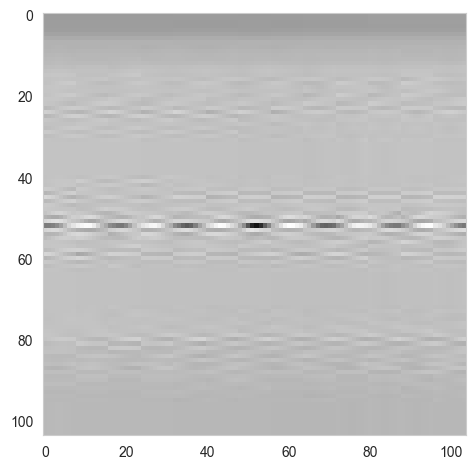

FA0004_GW01_H01_0202_20211108164145_farm_mic_snd_744caeef4f80_50.jpg : [81.23604]


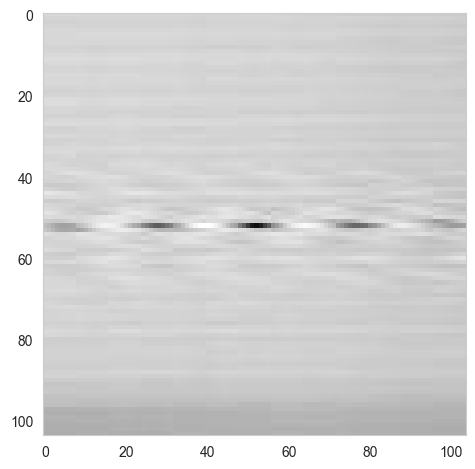

FA0004_GW01_H01_0202_20211108164145_farm_mic_snd_744caeef4f80_57.jpg : [66.65219]


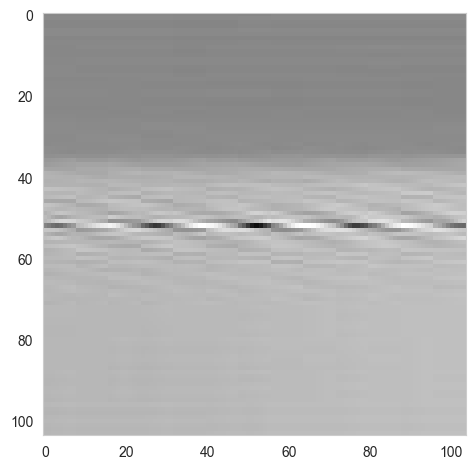

In [ ]:
# abnormal
# fileListabnormal = rawDf[(rawDf.recon_error > 10.) & (rawDf.recon_error < 30.) & (rawDf.isInfected == 1.0)]['fileName'].to_list()
fileListabnormal = rawDf[(rawDf.tsneClass == 0) & (rawDf.isInfected == 1.0)]['fileName'].to_list()
len(fileListabnormal)
for idx, aName in enumerate(fileListabnormal) : 
    if idx > 50 : break
    aFileName = '../output/ilt_20211108_20211109/abnormal/' + aName
    print(f"{aName} : {rawDf[rawDf.fileName == aName]['recon_error'].values}")
    aImg = plt.imread(aFileName)
    plt.imshow(aImg)
    # plt.axis('off')
    plt.grid(visible=False)
    plt.tight_layout()
    plt.show()

In [ ]:
import glob, os
pd.DataFrame([(os.path.basename(x),0) for x in glob.glob('../output/ilt_20211108_20211109/abnormal/' + os.path.sep + '*.jpg') ], columns = ['filename','label'])

,filename,label
0,FA0004_GW01_H01_0203_20211109131146_farm_mic_s...,0
1,FA0004_GW01_H01_0203_20211109151152_farm_mic_s...,0
2,FA0004_GW01_H01_0202_20211109003645_farm_mic_s...,0
3,FA0004_GW01_H01_0203_20211109050147_farm_mic_s...,0
4,FA0004_GW01_H01_0203_20211109193146_farm_mic_s...,0
...,...,...
51502,FA0004_GW01_H01_0203_20211109133650_farm_mic_s...,0
51503,FA0004_GW01_H01_0202_20211108204144_farm_mic_s...,0
51504,FA0004_GW01_H01_0202_20211108140144_farm_mic_s...,0
51505,FA0004_GW01_H01_0203_20211109212148_farm_mic_s...,0


88

FA0004_GW01_H01_0202_20211108020645_farm_mic_snd_dd483d8e4240_12.jpg : [54.63433]


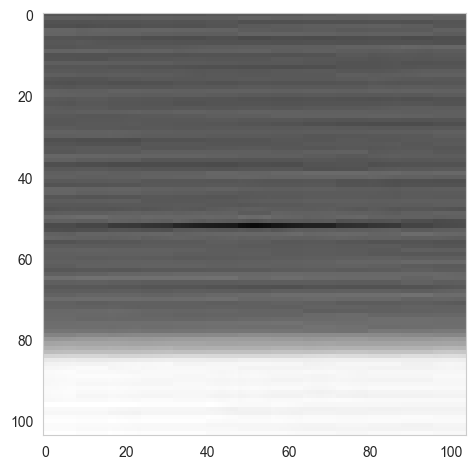

FA0004_GW01_H01_0202_20211108020645_farm_mic_snd_dd483d8e4240_26.jpg : [47.68431]


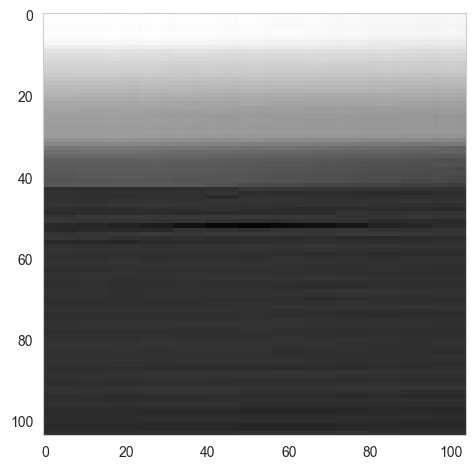

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_05.jpg : [63.656704]


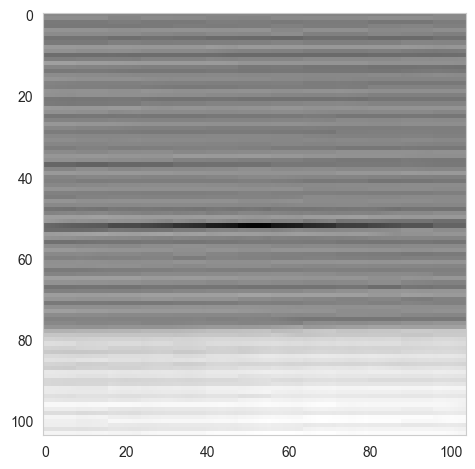

FA0004_GW01_H01_0202_20211108035145_farm_mic_snd_e13f81ad49ef_23.jpg : [33.866]


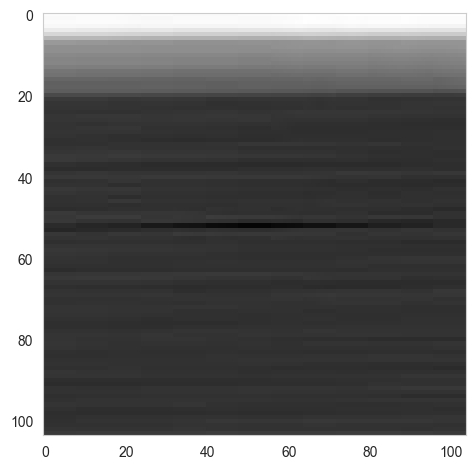

FA0004_GW01_H01_0202_20211108065144_farm_mic_snd_5473959d401d_27.jpg : [47.47404]


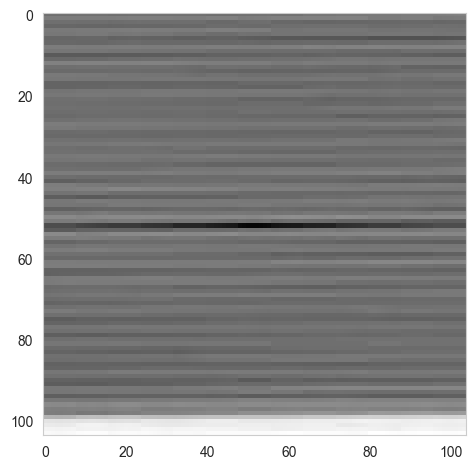

FA0004_GW01_H01_0202_20211108065144_farm_mic_snd_5473959d401d_28.jpg : [28.98969]


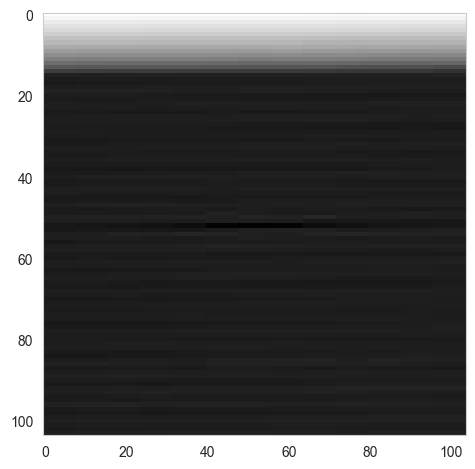

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_13.jpg : [59.21632]


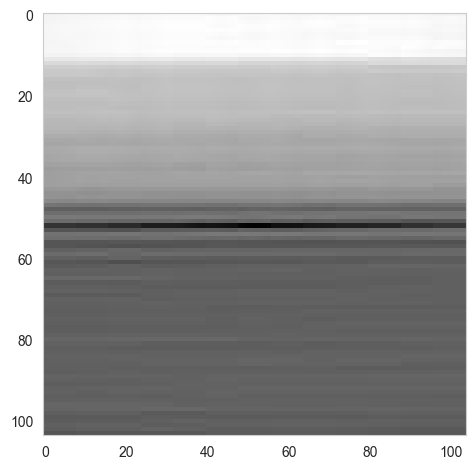

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_30.jpg : [55.708286]


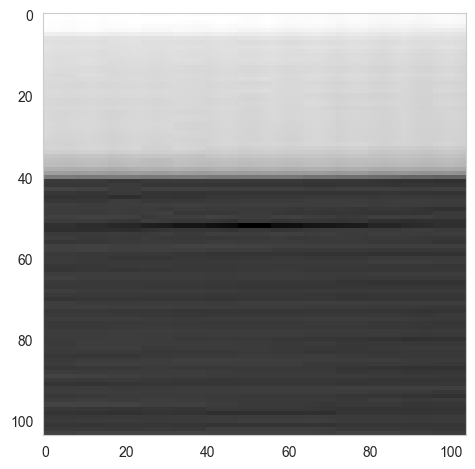

FA0004_GW01_H01_0202_20211108080145_farm_mic_snd_6426fdd34363_35.jpg : [53.031017]


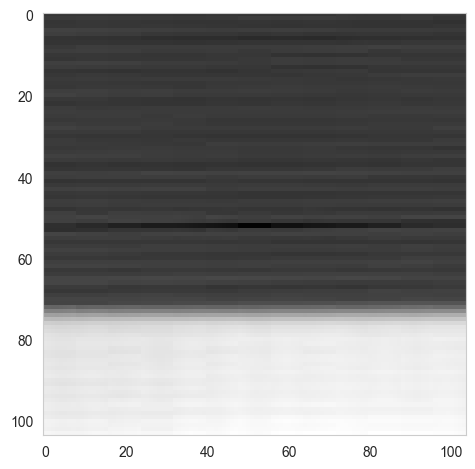

FA0004_GW01_H01_0202_20211108084144_farm_mic_snd_733c10ac4bd7_36.jpg : [64.02748]


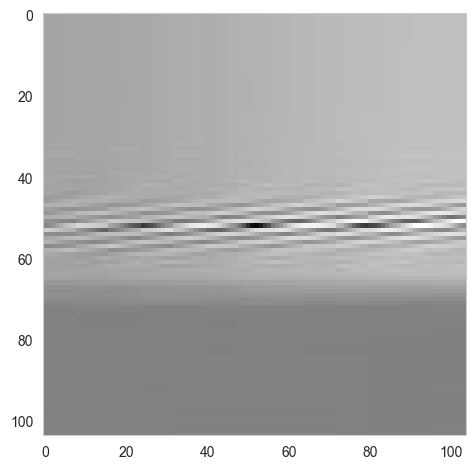

FA0004_GW01_H01_0202_20211108084144_farm_mic_snd_733c10ac4bd7_46.jpg : [54.72923]


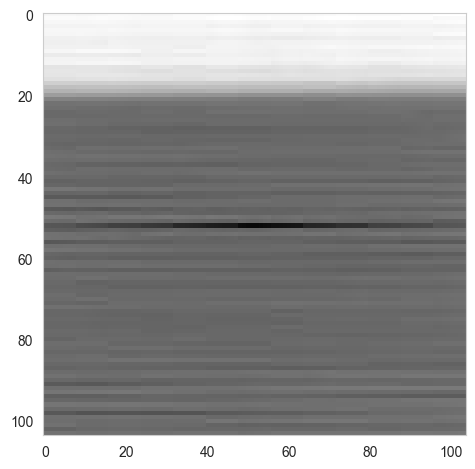

FA0004_GW01_H01_0202_20211108091144_farm_mic_snd_f7a3bcf049f0_00.jpg : [63.484615]


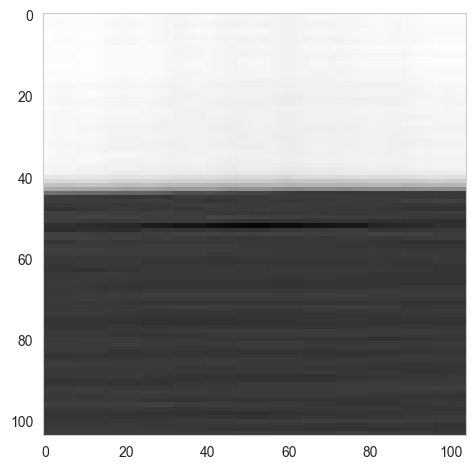

FA0004_GW01_H01_0202_20211108091144_farm_mic_snd_f7a3bcf049f0_14.jpg : [50.744366]


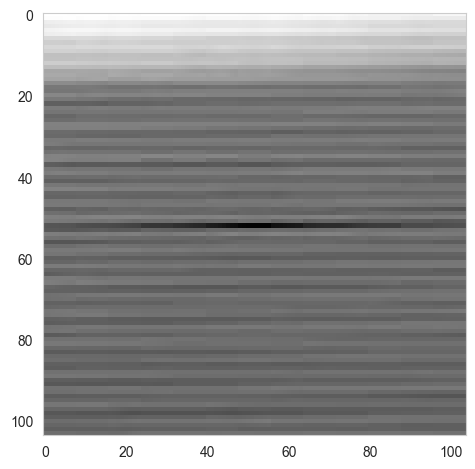

FA0004_GW01_H01_0202_20211108114143_farm_mic_snd_d476f28b4aea_27.jpg : [54.50243]


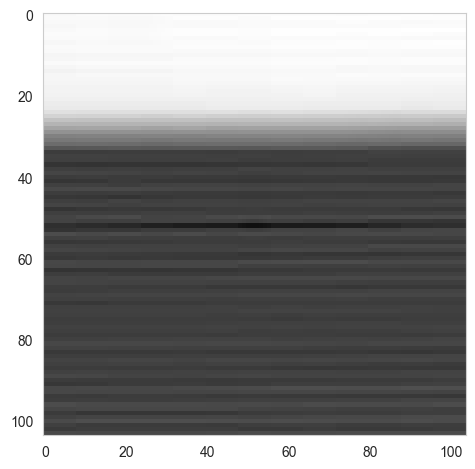

FA0004_GW01_H01_0202_20211108142145_farm_mic_snd_a263dc2048a5_33.jpg : [44.705585]


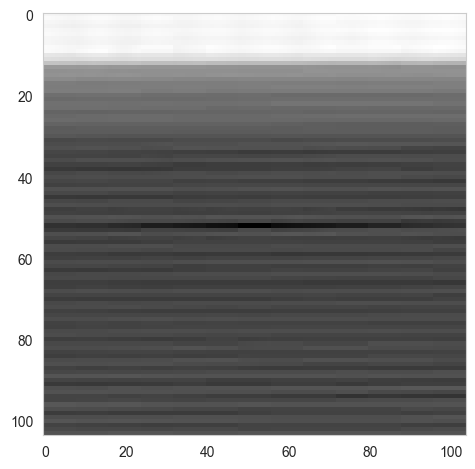

FA0004_GW01_H01_0202_20211108142145_farm_mic_snd_a263dc2048a5_50.jpg : [52.177]


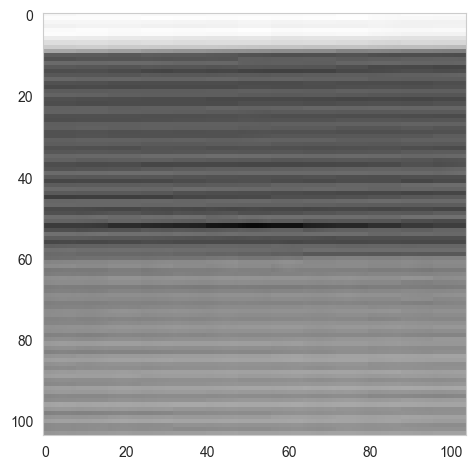

FA0004_GW01_H01_0202_20211108164145_farm_mic_snd_744caeef4f80_24.jpg : [63.30634]


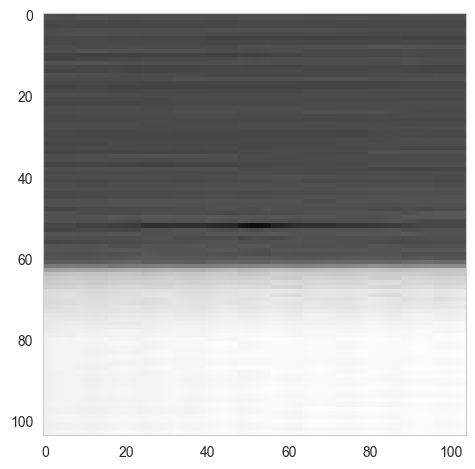

FA0004_GW01_H01_0202_20211108174644_farm_mic_snd_040230234071_25.jpg : [63.30458]


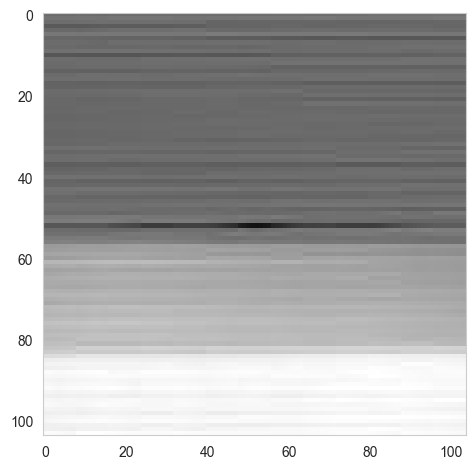

FA0004_GW01_H01_0202_20211108202145_farm_mic_snd_b77c036f472f_53.jpg : [59.826466]


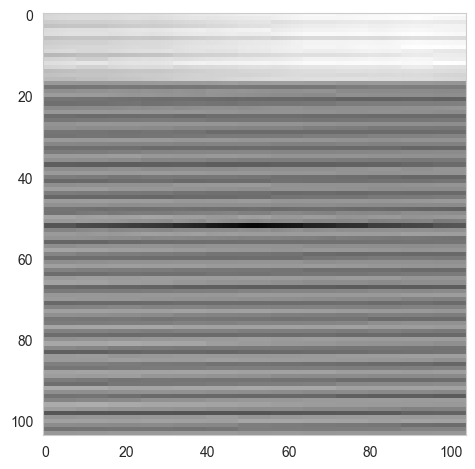

FA0004_GW01_H01_0202_20211108203644_farm_mic_snd_99eba2c0440b_49.jpg : [44.692333]


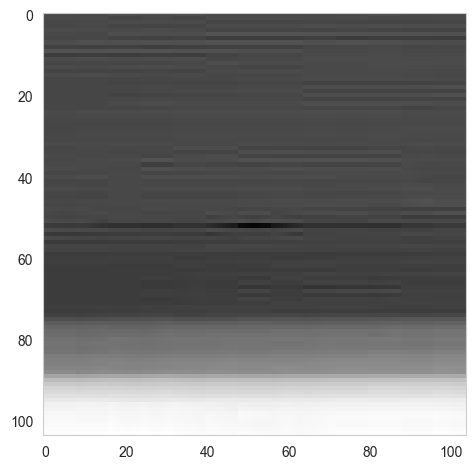

FA0004_GW01_H01_0202_20211108203644_farm_mic_snd_99eba2c0440b_50.jpg : [40.60253]


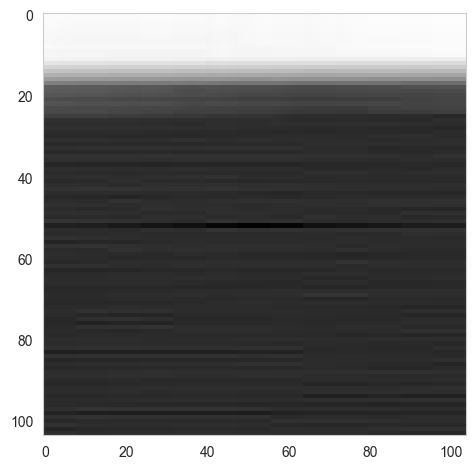

FA0004_GW01_H01_0202_20211109001645_farm_mic_snd_b777a1604689_56.jpg : [34.90121]


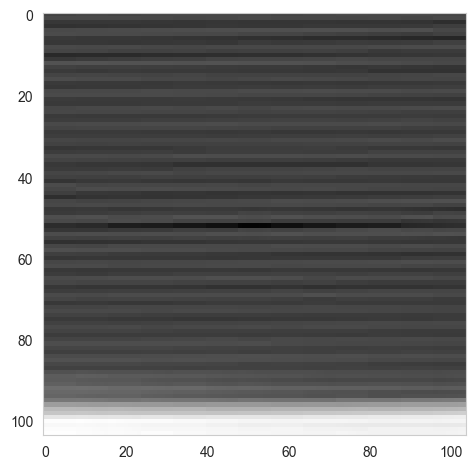

FA0004_GW01_H01_0202_20211109004145_farm_mic_snd_7c30f2d04298_51.jpg : [64.8294]


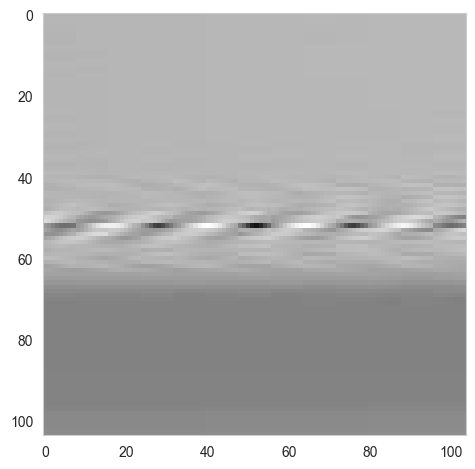

FA0004_GW01_H01_0202_20211109004145_farm_mic_snd_7c30f2d04298_52.jpg : [54.150517]


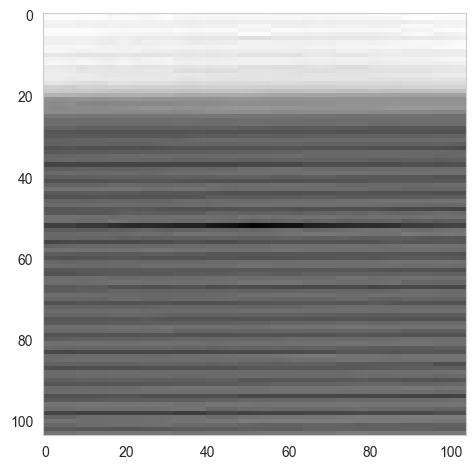

FA0004_GW01_H01_0202_20211109004145_farm_mic_snd_7c30f2d04298_53.jpg : [47.849976]


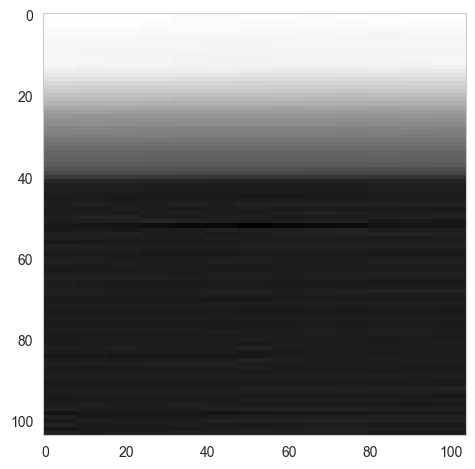

FA0004_GW01_H01_0202_20211109011145_farm_mic_snd_66d2005b4d76_30.jpg : [65.14561]


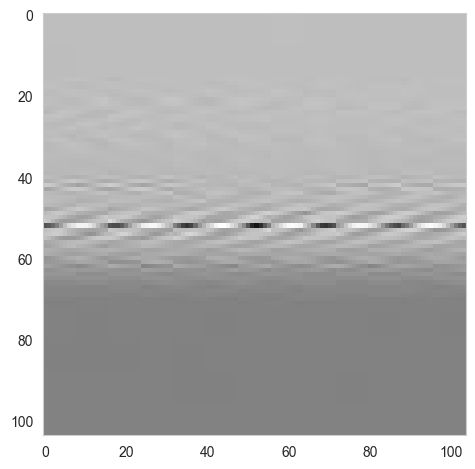

FA0004_GW01_H01_0202_20211109035644_farm_mic_snd_0bb0e48940bd_42.jpg : [55.20612]


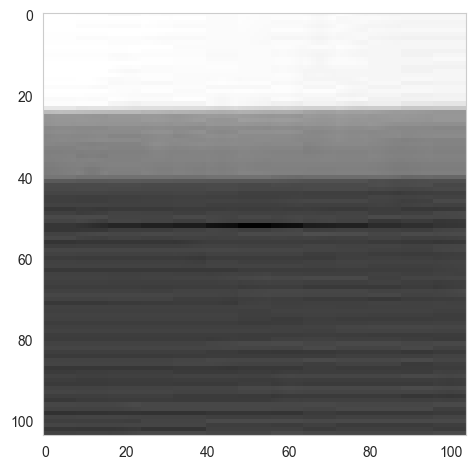

FA0004_GW01_H01_0202_20211109040145_farm_mic_snd_4c3c9566430b_09.jpg : [64.62388]


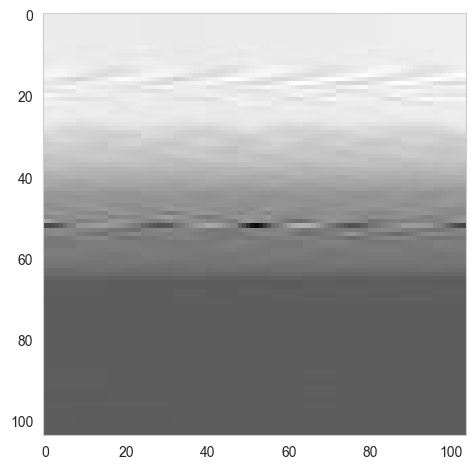

FA0004_GW01_H01_0202_20211109041645_farm_mic_snd_fee7de034b9b_30.jpg : [67.50922]


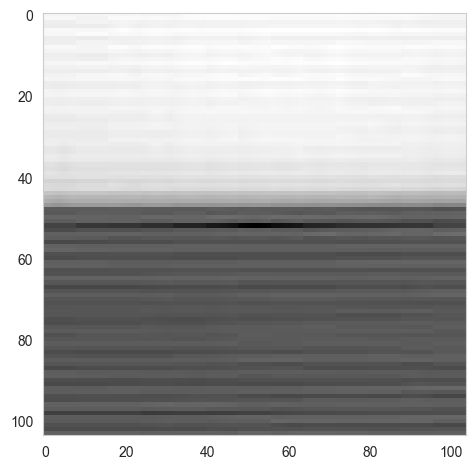

FA0004_GW01_H01_0202_20211109043146_farm_mic_snd_889a9ea04e01_25.jpg : [58.30321]


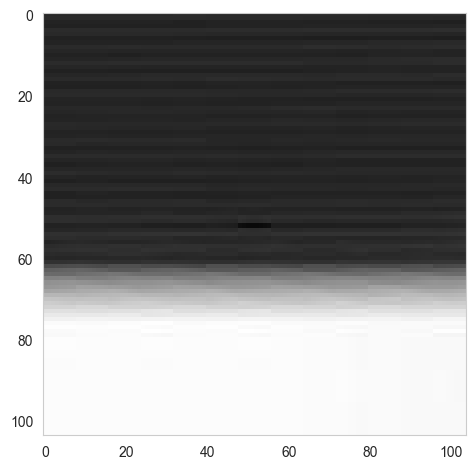

FA0004_GW01_H01_0202_20211109043146_farm_mic_snd_889a9ea04e01_29.jpg : [67.12459]


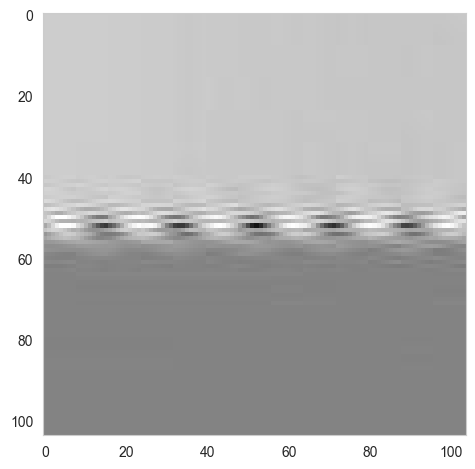

FA0004_GW01_H01_0202_20211109045646_farm_mic_snd_c05008614360_15.jpg : [42.41469]


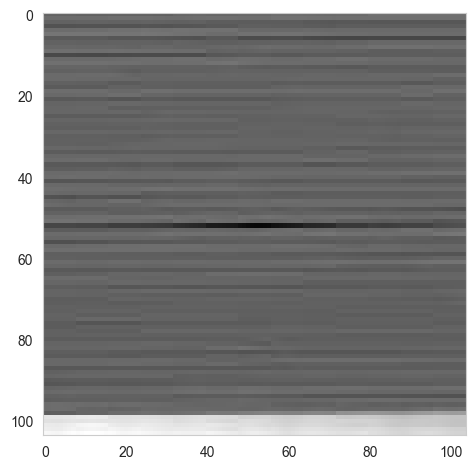

FA0004_GW01_H01_0202_20211109061645_farm_mic_snd_7a9aa2ef44f7_13.jpg : [46.680977]


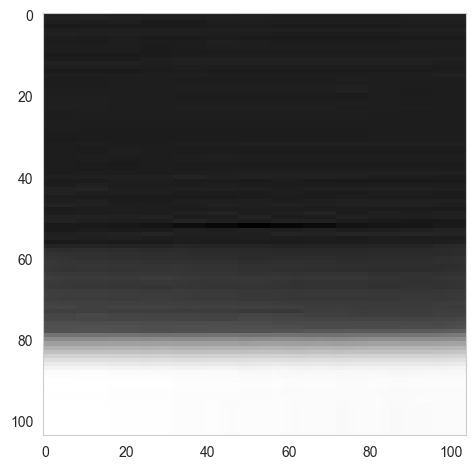

FA0004_GW01_H01_0202_20211109073649_farm_mic_snd_05c05dc14600_54.jpg : [64.96901]


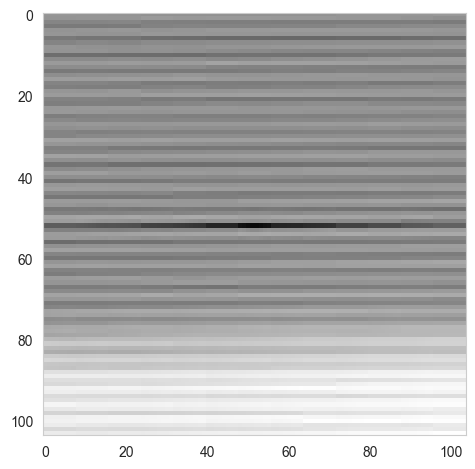

FA0004_GW01_H01_0202_20211109081147_farm_mic_snd_9d37a32b4777_26.jpg : [53.928207]


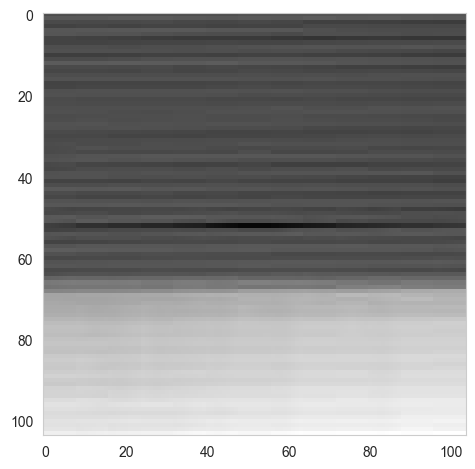

FA0004_GW01_H01_0202_20211109081147_farm_mic_snd_9d37a32b4777_41.jpg : [58.758522]


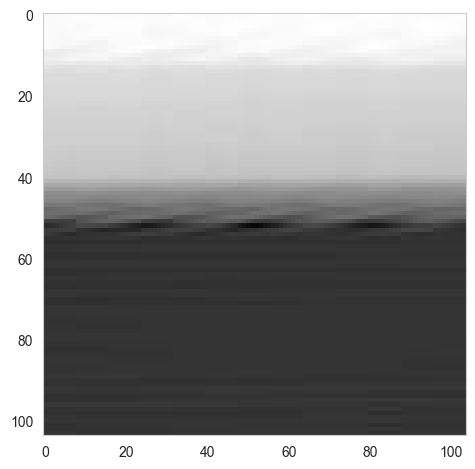

FA0004_GW01_H01_0202_20211109081147_farm_mic_snd_9d37a32b4777_47.jpg : [54.871304]


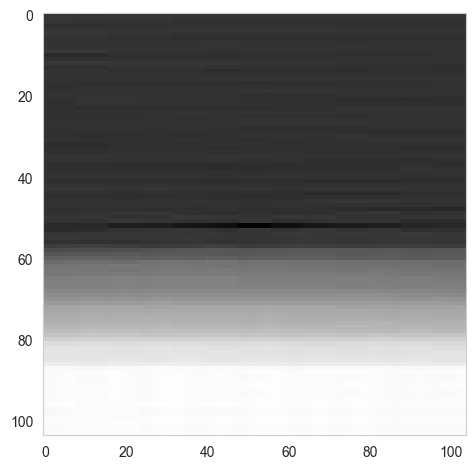

FA0004_GW01_H01_0202_20211109091147_farm_mic_snd_1569b63144e0_04.jpg : [59.66453]


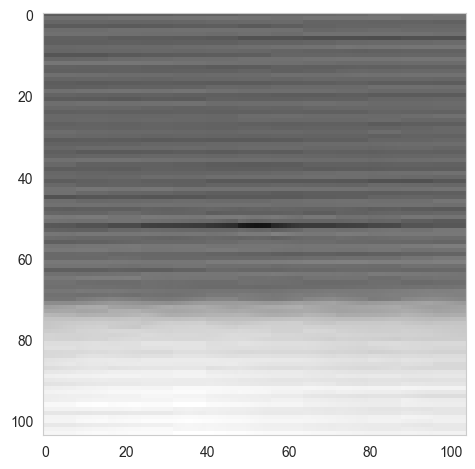

FA0004_GW01_H01_0202_20211109091147_farm_mic_snd_1569b63144e0_17.jpg : [59.391354]


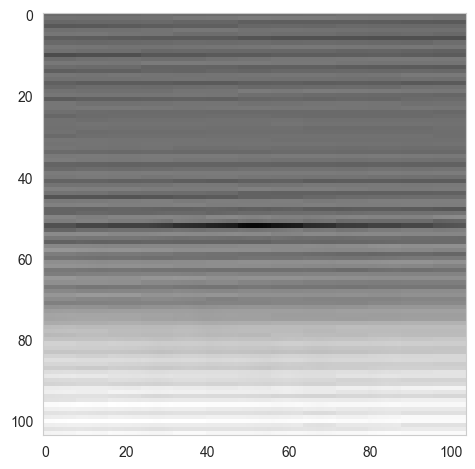

FA0004_GW01_H01_0202_20211109091147_farm_mic_snd_1569b63144e0_20.jpg : [67.995056]


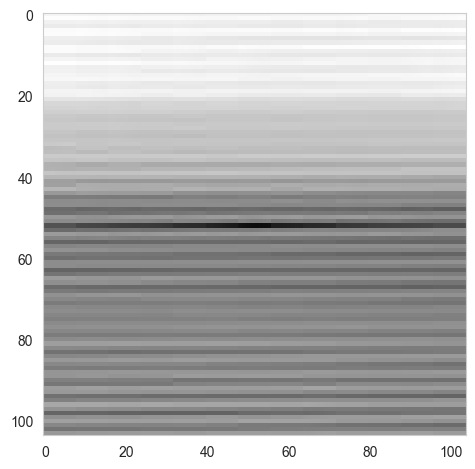

FA0004_GW01_H01_0202_20211109091648_farm_mic_snd_e6bc29a74101_18.jpg : [55.731976]


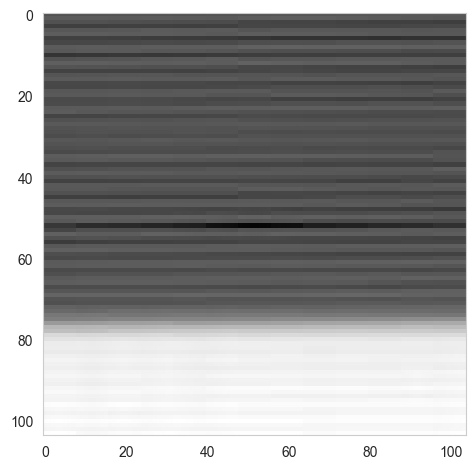

FA0004_GW01_H01_0202_20211109091648_farm_mic_snd_e6bc29a74101_52.jpg : [60.440655]


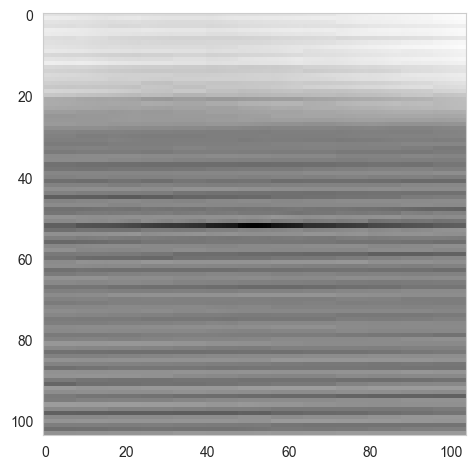

FA0004_GW01_H01_0202_20211109091648_farm_mic_snd_e6bc29a74101_54.jpg : [68.140205]


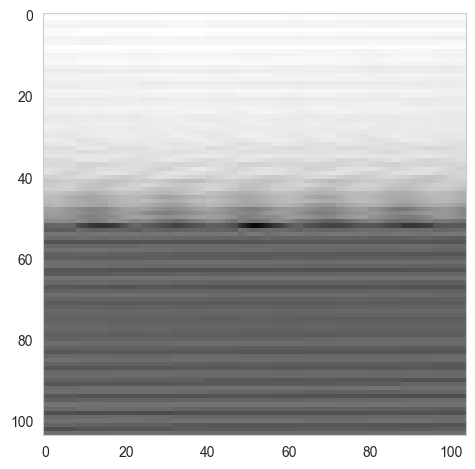

FA0004_GW01_H01_0202_20211109092647_farm_mic_snd_7a099f0d49da_21.jpg : [52.43956]


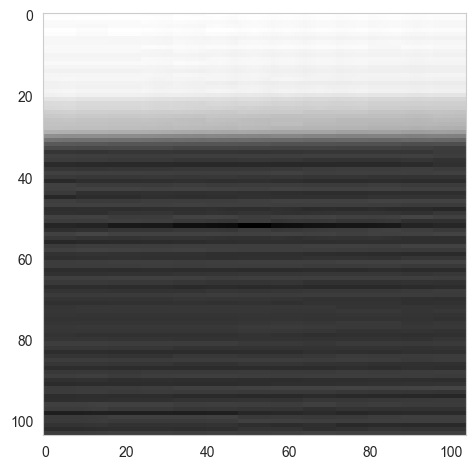

FA0004_GW01_H01_0202_20211109093645_farm_mic_snd_418b74944741_48.jpg : [64.50962]


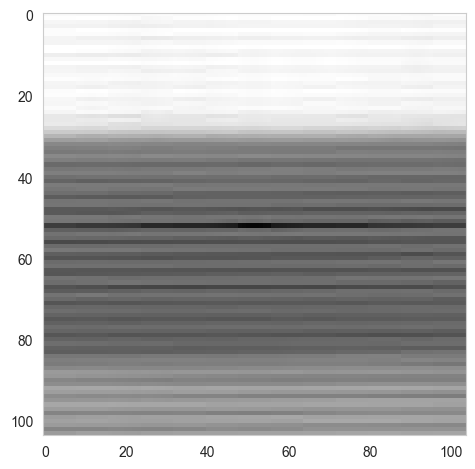

FA0004_GW01_H01_0202_20211109094648_farm_mic_snd_d9a40dc6470f_45.jpg : [61.23789]


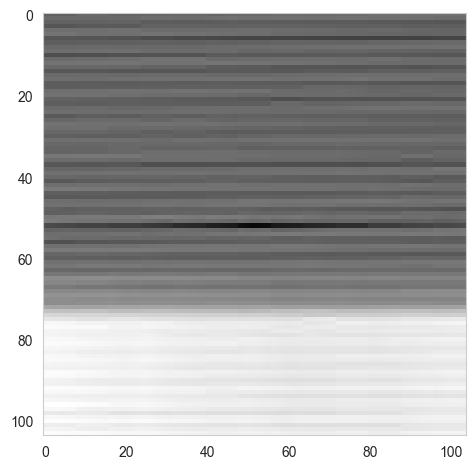

FA0004_GW01_H01_0202_20211109094648_farm_mic_snd_d9a40dc6470f_58.jpg : [61.96777]


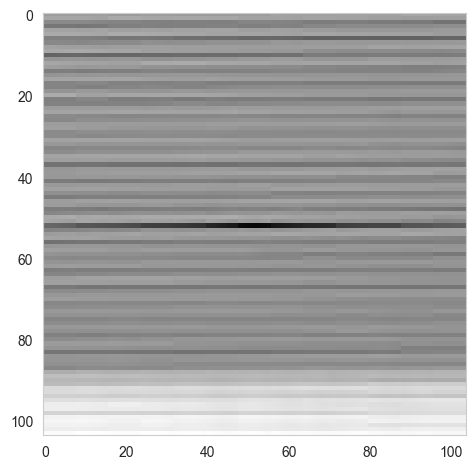

FA0004_GW01_H01_0202_20211109100148_farm_mic_snd_d9ff5f3c4c83_02.jpg : [55.473408]


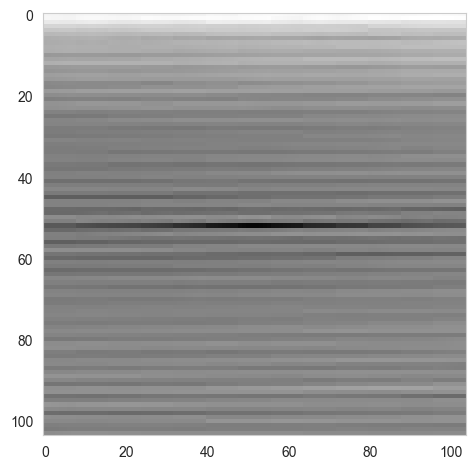

FA0004_GW01_H01_0202_20211109100646_farm_mic_snd_e83bb1e5410c_52.jpg : [52.65634]


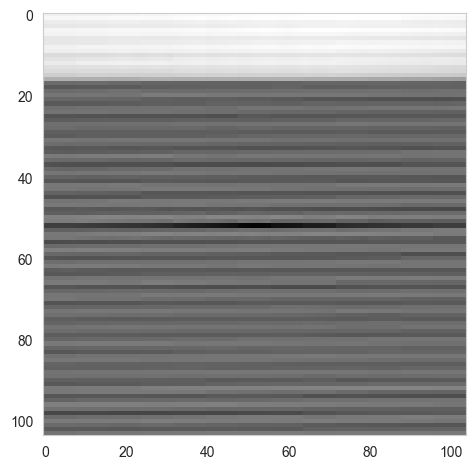

FA0004_GW01_H01_0202_20211109104144_farm_mic_snd_3111d6194da9_35.jpg : [57.82705]


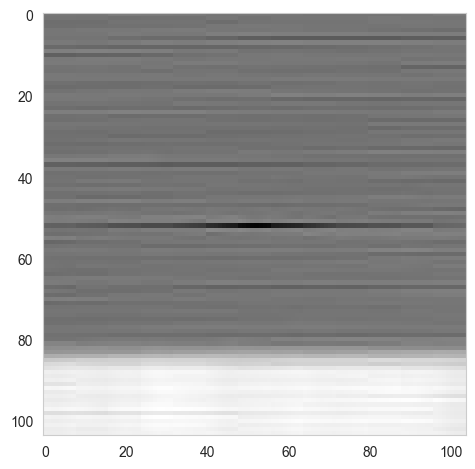

FA0004_GW01_H01_0202_20211109104144_farm_mic_snd_3111d6194da9_38.jpg : [59.642857]


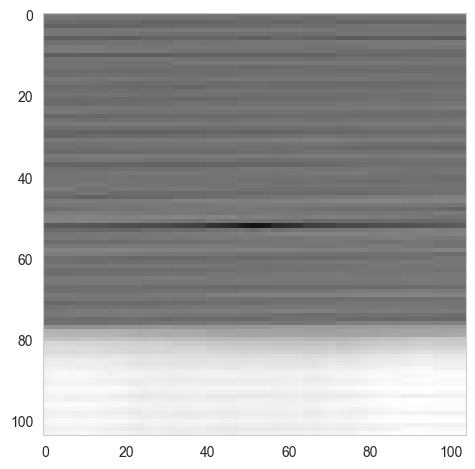

In [ ]:
# abnormal
# fileListabnormal = rawDf[(rawDf.recon_error > 10.) & (rawDf.recon_error < 30.) & (rawDf.isInfected == 1.0)]['fileName'].to_list()
fileListabnormal = rawDf[(rawDf.tsneClass == 1) & (rawDf.isInfected == 1.0)]['fileName'].to_list()
len(fileListabnormal)
for idx, aName in enumerate(fileListabnormal) : 
    if idx > 50 : break
    aFileName = '../output/ilt_20211108_20211109/abnormal/' + aName
    print(f"{aName} : {rawDf[rawDf.fileName == aName]['recon_error'].values}")
    aImg = plt.imread(aFileName)
    plt.imshow(aImg)
    # plt.axis('off')
    plt.grid(visible=False)
    plt.tight_layout()
    plt.show()

## TSNE

In [11]:
infIndex = rawDf[(rawDf.isInfected == 1.)].index.to_list()

In [12]:
rawDf.head(2)

,fileName,recon_error,t_v,lv,isInfected,createTime
0,FA0004_GW01_H01_0203_20211109131146_farm_mic_s...,9.586159,"[[-0.8614036, 0.21335429, 0.28881118, 0.359238]]","[0.48686913, 0.7065748, 0.4397973]",0.0,2021-11-09 13:11:46
1,FA0004_GW01_H01_0203_20211109151152_farm_mic_s...,9.365865,"[[-0.8645733, 0.2411249, 0.30799448, 0.31545392]]","[0.5021628, 0.5182144, 0.3891205]",0.0,2021-11-09 15:11:52


In [13]:
rawDf.isInfected.value_counts()
colors_pred_test = np.where(rawDf['isInfected'] == 1.0, 'abnormal','normal')
_colors_pred_test = np.where(rawDf['isInfected']  == 1.0, 'red','green')
normal_index = np.where(colors_pred_test =='normal')[0].tolist()
abnormal_index = np.where(colors_pred_test =='abnormal')[0].tolist()

0.0    51166
1.0      341
Name: isInfected, dtype: int64

### standard scaler

In [10]:
from sklearn.preprocessing import StandardScaler
X_test_results_test = list(zip(rawDf.recon_error,rawDf.t_v, rawDf.lv))
X_test_results_test = [[x[0], *x[1].flatten(),*x[2].flatten()] for x in X_test_results_test]
#X_test_results_test = [list(x[1].flatten()) for x in X_test_results_test]
# X_test_results_test

X_test_results_test = StandardScaler().fit(X_test_results_test).transform(X_test_results_test)
X_test_results_test
len(X_test_results_test)

array([[ 0.69663018,  0.12413758, -0.32575745, ..., -0.10898636,
         1.76233187, -0.51385165],
       [ 0.64130873, -0.23330778,  0.45759527, ...,  0.02079321,
         0.15405271, -0.94477096],
       [-0.39553006, -0.24521165,  0.52737537, ..., -1.73566687,
         0.90473936,  1.03020751],
       ...,
       [-0.84333968,  0.04993838,  0.03172998, ..., -0.84128517,
        -0.59646371,  0.16070252],
       [-0.6481637 ,  2.41314163, -3.92075844, ...,  0.36922399,
        -0.31863535,  0.53148736],
       [ 0.7618393 , -0.22838088,  0.43715623, ..., -0.5042732 ,
        -0.81532471,  0.76918643]])

51507

In [11]:
from sklearn.manifold import TSNE

# t-SNE 모델 생성 및 학습
tsne = TSNE(n_components=2, random_state=0, verbose=1, perplexity=100, n_iter=250)
digits_tsne_test = tsne.fit_transform(X_test_results_test)

/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 51507 samples in 0.030s...
[t-SNE] Computed neighbors for 51507 samples in 6.510s...
[t-SNE] Computed conditional probabilities for sample 1000 / 51507
[t-SNE] Computed conditional probabilities for sample 2000 / 51507
[t-SNE] Computed conditional probabilities for sample 3000 / 51507
[t-SNE] Computed conditional probabilities for sample 4000 / 51507
[t-SNE] Computed conditional probabilities for sample 5000 / 51507
[t-SNE] Computed conditional probabilities for sample 6000 / 51507
[t-SNE] Computed conditional probabilities for sample 7000 / 51507
[t-SNE] Computed conditional probabilities for sample 8000 / 51507
[t-SNE] Computed conditional probabilities for sample 9000 / 51507
[t-SNE] Computed conditional probabilities for sample 10000 / 51507
[t-SNE] Computed conditional probabilities for sample 11000 / 51507
[t-SNE] Computed conditional probabilities for sample 12000 / 51507
[t-SNE] Computed conditional probabilities for sa

In [12]:
rawDf.isInfected.value_counts()
colors_pred_test = np.where(rawDf['isInfected'] == 1.0, 'abnormal','normal')
_colors_pred_test = np.where(rawDf['isInfected']  == 1.0, 'red','green')
normal_index = np.where(colors_pred_test =='normal')[0].tolist()
abnormal_index = np.where(colors_pred_test =='abnormal')[0].tolist()

0.0    51166
1.0      341
Name: isInfected, dtype: int64

In [21]:
infIndex = rawDf[(rawDf.isInfected == 1.) & (rawDf.recon_error >= 15.)].index.to_list()

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'normal')

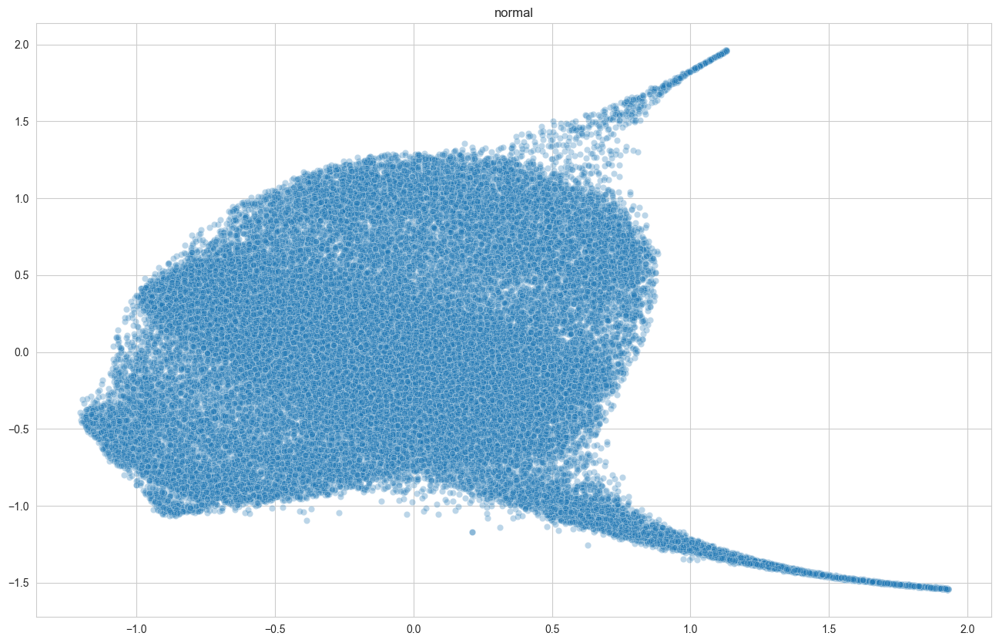

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'abnormal')

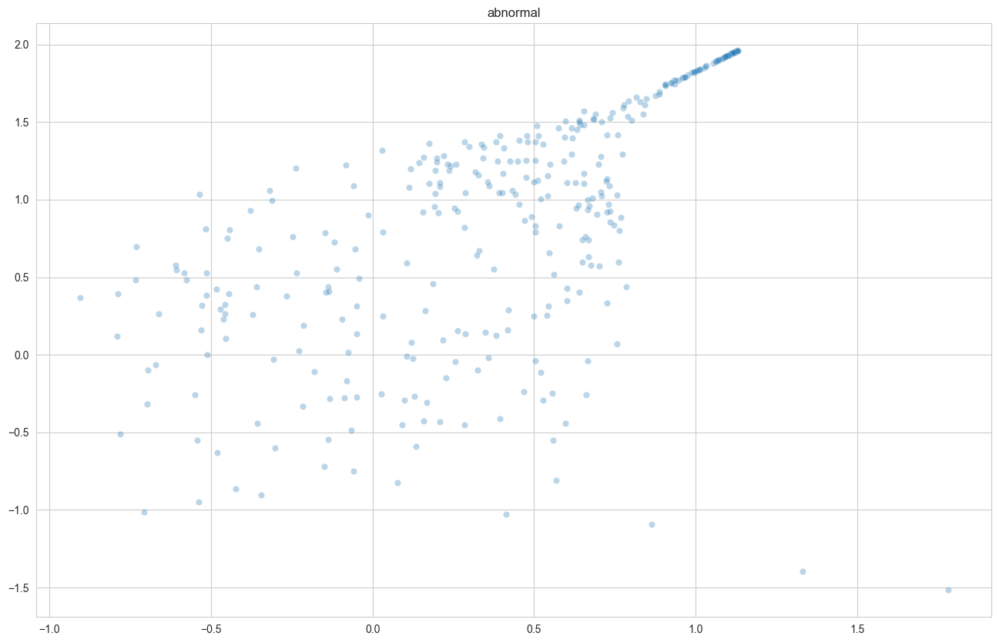

<Figure size 1600x1000 with 0 Axes>

<AxesSubplot: >

/var/folders/v0/dn_8jzmd0396fq71hnvs0rc80000gn/T/ipykernel_25145/543471900.py:55: MatplotlibDeprecationWarning:

Passing argument *p* of unexpected type Line2D to add_patch which only accepts <class 'matplotlib.patches.Patch'> is deprecated since 3.5 and will become an error two minor releases later.



Text(0.5, 1.0, 'all')

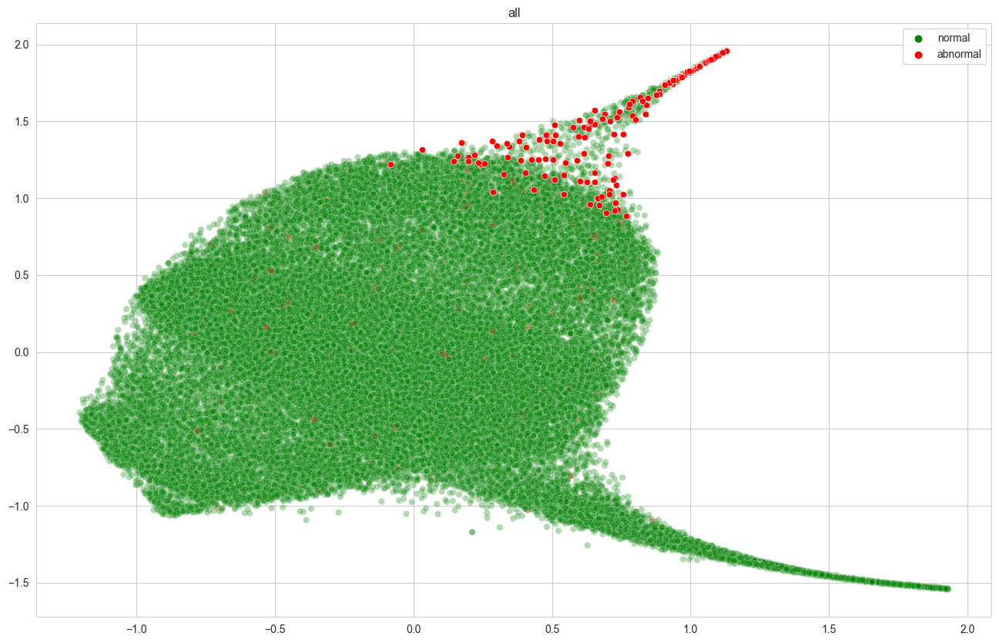

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
# circle1 = plt.Circle(xy=(0, 0), radius=53, color='red', fill=False)
ax = sns.scatterplot(
    x=digits_tsne_test[normal_index,0], y=digits_tsne_test[normal_index,1],
    # palette=sns.color_palette("hls", 2),hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("normal")
plt.show() 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
# circle1 = plt.Circle(xy=(0, 0), radius=53, color='red', fill=False)
ax = sns.scatterplot(
    x=digits_tsne_test[abnormal_index,0], y=digits_tsne_test[abnormal_index,1],
    # palette=sns.color_palette("hls", 2),hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("abnormal")
plt.show() 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=digits_tsne_test[:,0], y=digits_tsne_test[:,1],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

sns.scatterplot(
    x=digits_tsne_test[infIndex,0], y=digits_tsne_test[infIndex,1],
    color='red',
    legend="full"
)

xx, yy = [6.5,6.5,8.], [8,2,2]
from matplotlib.lines import Line2D
line1 = Line2D(xx,yy)
# ax.add_patch(circle1)
ax.add_patch(line1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 




In [16]:
from sklearn.manifold import TSNE

# t-SNE 모델 생성 및 학습
tsne3d = TSNE(n_components=3, random_state=0, verbose=1, perplexity=100, n_iter=250)
digits_tsne_test_3d = tsne3d.fit_transform(X_test_results_test)

/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 51507 samples in 0.028s...
[t-SNE] Computed neighbors for 51507 samples in 6.326s...
[t-SNE] Computed conditional probabilities for sample 1000 / 51507
[t-SNE] Computed conditional probabilities for sample 2000 / 51507
[t-SNE] Computed conditional probabilities for sample 3000 / 51507
[t-SNE] Computed conditional probabilities for sample 4000 / 51507
[t-SNE] Computed conditional probabilities for sample 5000 / 51507
[t-SNE] Computed conditional probabilities for sample 6000 / 51507
[t-SNE] Computed conditional probabilities for sample 7000 / 51507
[t-SNE] Computed conditional probabilities for sample 8000 / 51507
[t-SNE] Computed conditional probabilities for sample 9000 / 51507
[t-SNE] Computed conditional probabilities for sample 10000 / 51507
[t-SNE] Computed conditional probabilities for sample 11000 / 51507
[t-SNE] Computed conditional probabilities for sample 12000 / 51507
[t-SNE] Computed conditional probabilities for sa

In [17]:
import plotly.express as px
px_plot_df = pd.DataFrame({'col_x' : digits_tsne_test_3d[:,0], 
                           'col_y' : digits_tsne_test_3d[:,1], 
                           'col_z' : digits_tsne_test_3d[:,2], 
                           'cat' : rawDf.isInfected})
px_plot_df['point_size'] = px_plot_df.cat * 20 + 1.
px_plot_df.head(2)

color_plot = np.where(px_plot_df['cat'] == 1., 'red','green').tolist()
fig = px.scatter_3d(px_plot_df, x='col_x', y='col_y', z='col_z',
                    color=color_plot, size='point_size', color_discrete_map="identity",
                    title="3D Scatter Plot")
fig.update_traces(marker_size = 1)
# fig.show()

,col_x,col_y,col_z,cat,point_size
0,-0.107143,0.757445,-0.580436,0.0,1.0
1,0.193066,-0.027149,0.961963,0.0,1.0


In [21]:
fig = px.scatter_3d(px_plot_df, x='col_x', y='col_y', z='col_z',
                    color=color_plot, size='point_size', color_discrete_map="identity",
                    title="3D Scatter Plot")
# fig.update_traces(marker_size = 1)
fig.show()

#### 3d ... plots using only 2-axises

In [12]:
infIndex = rawDf[(rawDf.isInfected == 1.) & (rawDf.recon_error >= 10.)\
    ].index.to_list()

In [13]:
from sklearn.preprocessing import StandardScaler
X_test_results_test = list(zip(rawDf.recon_error,rawDf.t_v))
X_test_results_test = [[x[0], *x[1].flatten()] for x in X_test_results_test]
#X_test_results_test = [list(x[1].flatten()) for x in X_test_results_test]
# X_test_results_test

X_test_results_test = StandardScaler().fit(X_test_results_test).transform(X_test_results_test)
# X_test_results_test
len(X_test_results_test)

116761

In [14]:
from sklearn.manifold import TSNE

# t-SNE 모델 생성 및 학습
tsne3d = TSNE(n_components=3, random_state=0, verbose=1, perplexity=100, n_iter=250)
digits_tsne_test_3d = tsne3d.fit_transform(X_test_results_test)

/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 116761 samples in 0.049s...
[t-SNE] Computed neighbors for 116761 samples in 5.538s...
[t-SNE] Computed conditional probabilities for sample 1000 / 116761
[t-SNE] Computed conditional probabilities for sample 2000 / 116761
[t-SNE] Computed conditional probabilities for sample 3000 / 116761
[t-SNE] Computed conditional probabilities for sample 4000 / 116761
[t-SNE] Computed conditional probabilities for sample 5000 / 116761
[t-SNE] Computed conditional probabilities for sample 6000 / 116761
[t-SNE] Computed conditional probabilities for sample 7000 / 116761
[t-SNE] Computed conditional probabilities for sample 8000 / 116761
[t-SNE] Computed conditional probabilities for sample 9000 / 116761
[t-SNE] Computed conditional probabilities for sample 10000 / 116761
[t-SNE] Computed conditional probabilities for sample 11000 / 116761
[t-SNE] Computed conditional probabilities for sample 12000 / 116761
[t-SNE] Computed conditional probab

[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.208664
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000


<Figure size 1600x1000 with 0 Axes>

<AxesSubplot: >

/var/folders/v0/dn_8jzmd0396fq71hnvs0rc80000gn/T/ipykernel_22464/130728561.py:21: MatplotlibDeprecationWarning: Passing argument *p* of unexpected type Line2D to add_patch which only accepts <class 'matplotlib.patches.Patch'> is deprecated since 3.5 and will become an error two minor releases later.
  ax.add_patch(line1)


Text(0.5, 1.0, 'all')

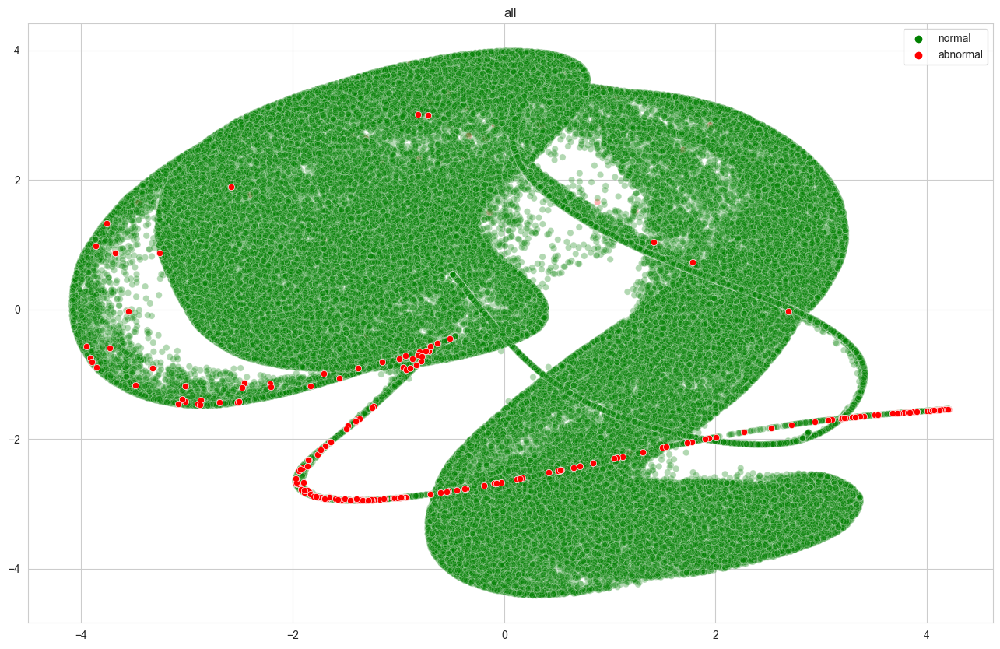

In [15]:

x_axis, y_axis = 0, 1
plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=digits_tsne_test_3d[:,0], y=digits_tsne_test_3d[:,1],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

sns.scatterplot(
    x=digits_tsne_test_3d[infIndex,x_axis], y=digits_tsne_test_3d[infIndex,y_axis],
    color='red',
    legend="full"
)

xx, yy = [6.5,6.5,8.], [8,2,2]
from matplotlib.lines import Line2D
line1 = Line2D(xx,yy)
# ax.add_patch(circle1)
ax.add_patch(line1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 

<Figure size 1600x1000 with 0 Axes>

<AxesSubplot: >

/var/folders/v0/dn_8jzmd0396fq71hnvs0rc80000gn/T/ipykernel_22464/2862692781.py:21: MatplotlibDeprecationWarning: Passing argument *p* of unexpected type Line2D to add_patch which only accepts <class 'matplotlib.patches.Patch'> is deprecated since 3.5 and will become an error two minor releases later.
  ax.add_patch(line1)


Text(0.5, 1.0, 'all')

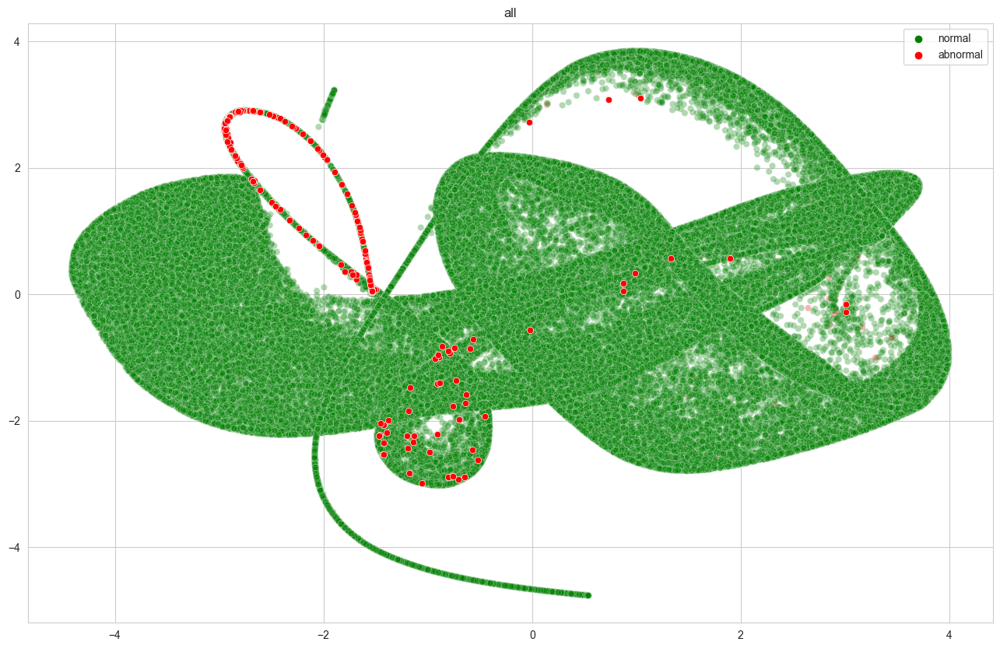

In [16]:

x_axis, y_axis = 1, 2
plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=digits_tsne_test_3d[:,x_axis], y=digits_tsne_test_3d[:,y_axis],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

sns.scatterplot(
    x=digits_tsne_test_3d[infIndex,x_axis], y=digits_tsne_test_3d[infIndex,y_axis],
    color='red',
    legend="full"
)

xx, yy = [6.5,6.5,8.], [8,2,2]
from matplotlib.lines import Line2D
line1 = Line2D(xx,yy)
# ax.add_patch(circle1)
ax.add_patch(line1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 

<Figure size 1600x1000 with 0 Axes>

<AxesSubplot: >

/var/folders/v0/dn_8jzmd0396fq71hnvs0rc80000gn/T/ipykernel_22464/4139734878.py:21: MatplotlibDeprecationWarning: Passing argument *p* of unexpected type Line2D to add_patch which only accepts <class 'matplotlib.patches.Patch'> is deprecated since 3.5 and will become an error two minor releases later.
  ax.add_patch(line1)


Text(0.5, 1.0, 'all')

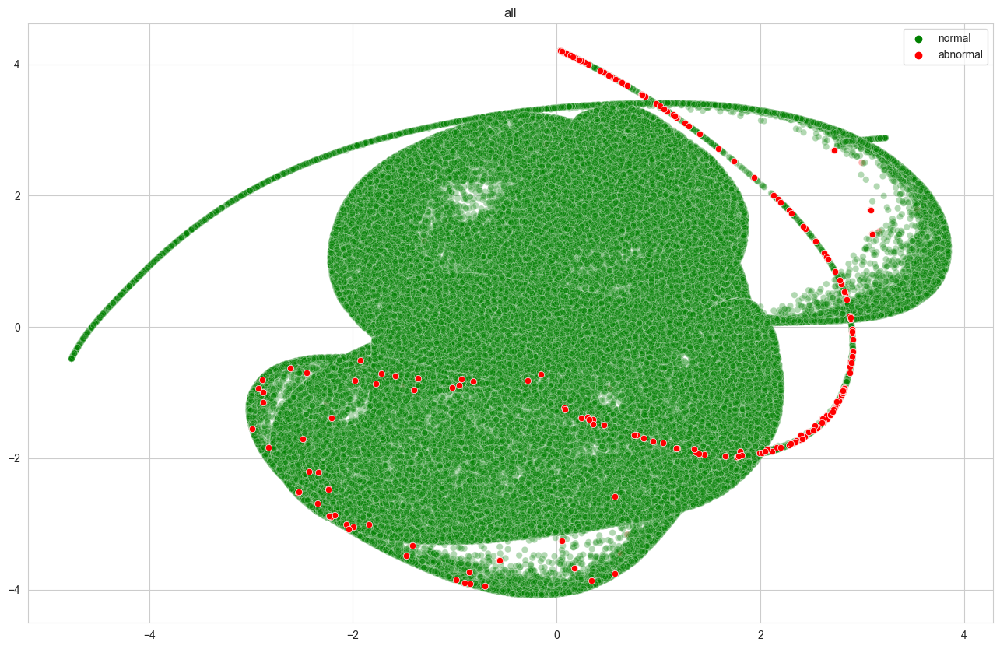

In [17]:

x_axis, y_axis = 2, 0
plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=digits_tsne_test_3d[:,x_axis], y=digits_tsne_test_3d[:,y_axis],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

sns.scatterplot(
    x=digits_tsne_test_3d[infIndex,x_axis], y=digits_tsne_test_3d[infIndex,y_axis],
    color='red',
    legend="full"
)

xx, yy = [6.5,6.5,8.], [8,2,2]
from matplotlib.lines import Line2D
line1 = Line2D(xx,yy)
# ax.add_patch(circle1)
ax.add_patch(line1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 

#### 3d-plot

In [18]:
infIndex = rawDf[(rawDf.isInfected == 1.) & (rawDf.recon_error >= 10.)\
    ].index.to_list()

In [32]:
px_plot_df = pd.DataFrame({'col_x' : digits_tsne_test_3d[infIndex,0], 
                           'col_y' : digits_tsne_test_3d[infIndex,1], 
                           'col_z' : digits_tsne_test_3d[infIndex,2], 
                           'cat' : rawDf.iloc[infIndex,:].isInfected})
px_plot_df['point_size'] = px_plot_df.cat * 20 + 1.
px_plot_df.head(2)

color_plot = np.where(px_plot_df['cat'] == 1., 'red','green').tolist()

,col_x,col_y,col_z,cat,point_size
732,7.043191,-0.704590,-3.430076,1.0,21.0
757,7.055046,-0.494889,-3.519501,1.0,21.0


In [33]:
import plotly.express as px

fig = px.scatter_3d(px_plot_df, x='col_x', y='col_y', z='col_z',
                    color=color_plot, size='point_size', color_discrete_map="identity",
                    title="3D Scatter Plot")
fig.update_traces(marker_size = 1)
# fig.show()

#### edit boundaries

<Figure size 1600x1000 with 0 Axes>

<AxesSubplot: >

Text(0.5, 1.0, 'all')

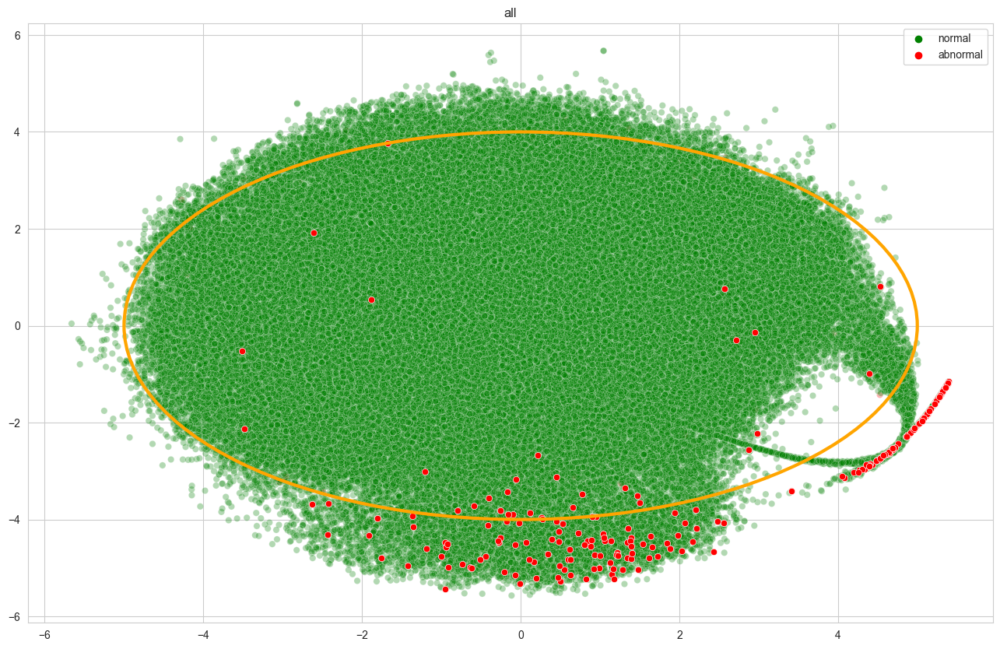

In [49]:

x_axis, y_axis = 0, 1
plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=digits_tsne_test_3d[:,0], y=digits_tsne_test_3d[:,1],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

sns.scatterplot(
    x=digits_tsne_test_3d[infIndex,x_axis], y=digits_tsne_test_3d[infIndex,y_axis],
    color='red',
    legend="full"
)

xx, yy = [6.5,6.5,8.], [8,2,2]
from matplotlib.lines import Line2D
from matplotlib.patches import Ellipse
ellipse1 = Ellipse(xy=(0,0), width=10., height=8., fill=False, color='orange', lw = 3.)
line1 = Line2D(xx,yy)
# ax.add_patch(circle1)
ax.add_patch(ellipse1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 

## setup vector to columns 

In [8]:
len(rawDf.t_v[0].flatten().tolist())
len(rawDf.lv[0])

# t_v
for idx in range(len(rawDf.t_v[0].flatten().tolist())) : 
    # print(f't_v_{idx+1} : {[x.flatten()[idx] for x in rawDf.t_v]}')
    rawDf[f"t_v_{idx+1}"] = [x.flatten()[idx] for x in rawDf.t_v]

# lv
for idx in range(len(rawDf.lv[0])) : 
    # print(f't_v_{idx+1} : {[x.flatten()[idx] for x in rawDf.t_v]}')
    rawDf[f"lv_{str(idx+1).zfill(2)}"] = [x[idx] for x in rawDf.lv]

rawDf.head(2)

4

3

,fileName,recon_error,t_v,lv,isInfected,createTime,t_v_1,t_v_2,t_v_3,t_v_4,lv_01,lv_02,lv_03
0,FA0004_GW01_H01_0203_20211109131146_farm_mic_s...,9.609886,"[[-0.8654469, 0.25864393, 0.30327436, 0.303528...","[0.31138313, 0.6588312, 0.4937598]",0.0,2021-11-09 13:11:46,-0.865447,0.258644,0.303274,0.303529,0.311383,0.658831,0.493760
1,FA0004_GW01_H01_0203_20211109151152_farm_mic_s...,9.621607,"[[-0.8654292, 0.25818628, 0.30332878, 0.303914...","[0.6246033, 0.4488139, 0.5739907]",0.0,2021-11-09 15:11:52,-0.865429,0.258186,0.303329,0.303914,0.624603,0.448814,0.573991


In [14]:
from re import search 
corrDf = rawDf[[x for x in rawDf.columns if search('t_v_|lv_|isIn|recon_error', x)]]
corrDf_Y = rawDf.isInfected
corrDf.head(2)

,recon_error,isInfected,t_v_1,t_v_2,t_v_3,t_v_4,lv_01,lv_02,lv_03
0,9.609886,0.0,-0.865447,0.258644,0.303274,0.303529,0.311383,0.658831,0.493760
1,9.621607,0.0,-0.865429,0.258186,0.303329,0.303914,0.624603,0.448814,0.573991


In [15]:
XX = corrDf[[x for x in corrDf.columns if ('isIn' not in x) ]] # and ('lv' not in x)
YY = corrDf.isInfected
XX.head(2)

,recon_error,t_v_1,t_v_2,t_v_3,t_v_4,lv_01,lv_02,lv_03
0,9.609886,-0.865447,0.258644,0.303274,0.303529,0.311383,0.658831,0.493760
1,9.621607,-0.865429,0.258186,0.303329,0.303914,0.624603,0.448814,0.573991


<Figure size 2000x2000 with 0 Axes>

KeyboardInterrupt: 

<Figure size 2000x2000 with 0 Axes>

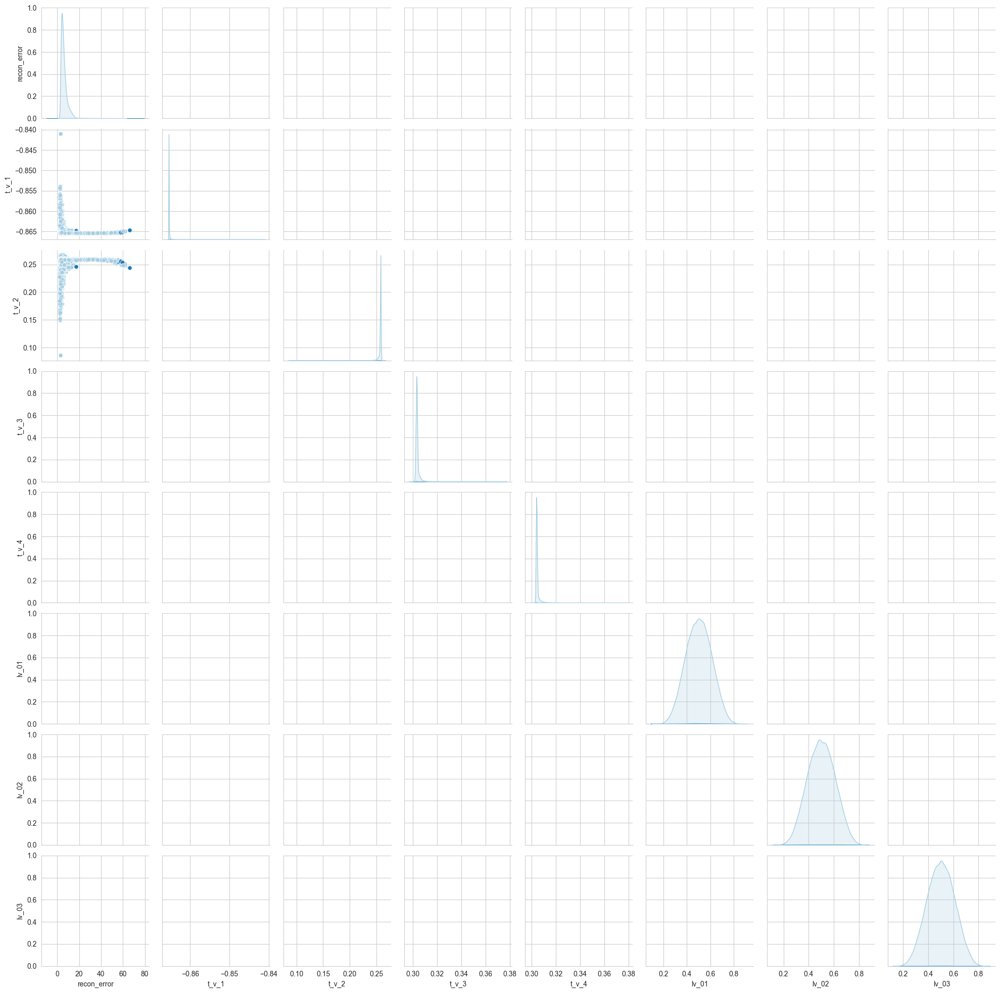

In [16]:
plt.figure(figsize=(20,20))
sns.pairplot(corrDf, hue='isInfected', palette= 'Paired')
plt.show()

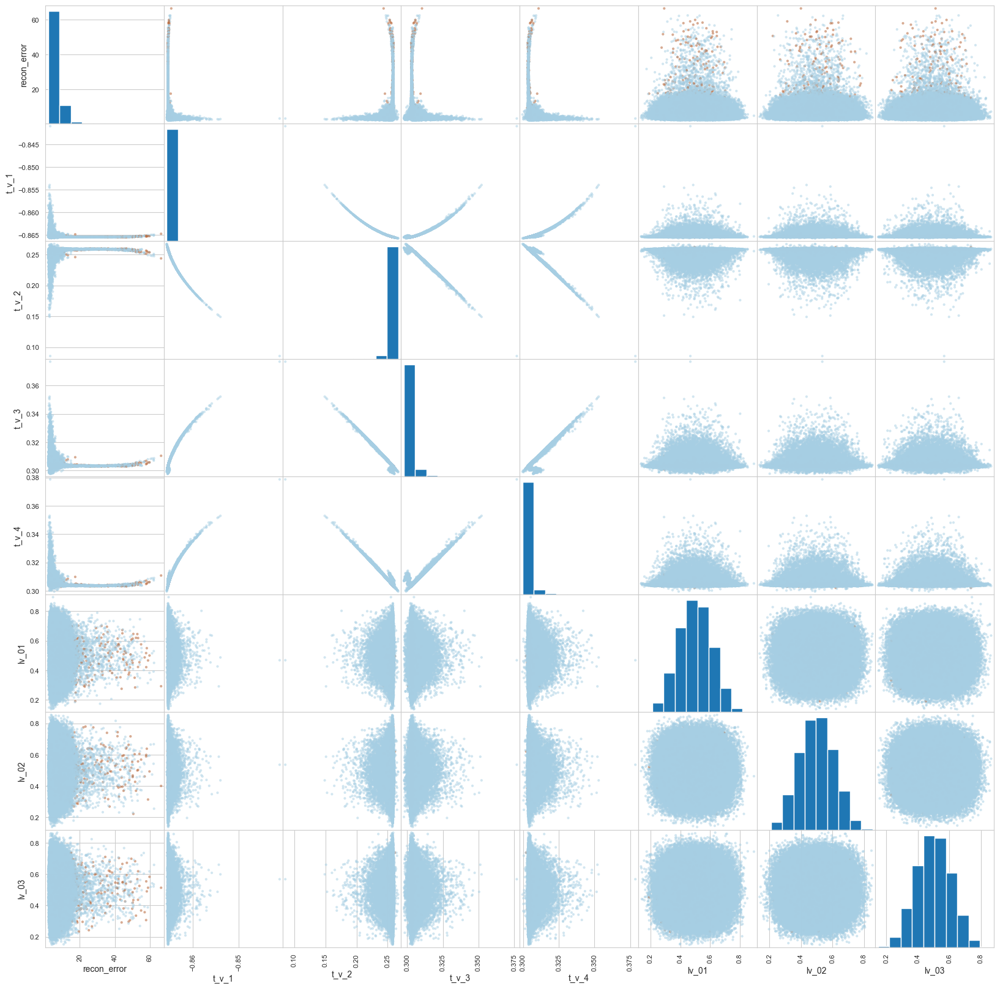

In [17]:
_ = pd.plotting.scatter_matrix(XX,c=YY, figsize=(20,20), cmap='Paired') # RdYlGn_r
plt.show()

/var/folders/v0/dn_8jzmd0396fq71hnvs0rc80000gn/T/ipykernel_67005/4262533667.py:5: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(dfdf, dtype=np.bool)


<AxesSubplot: >

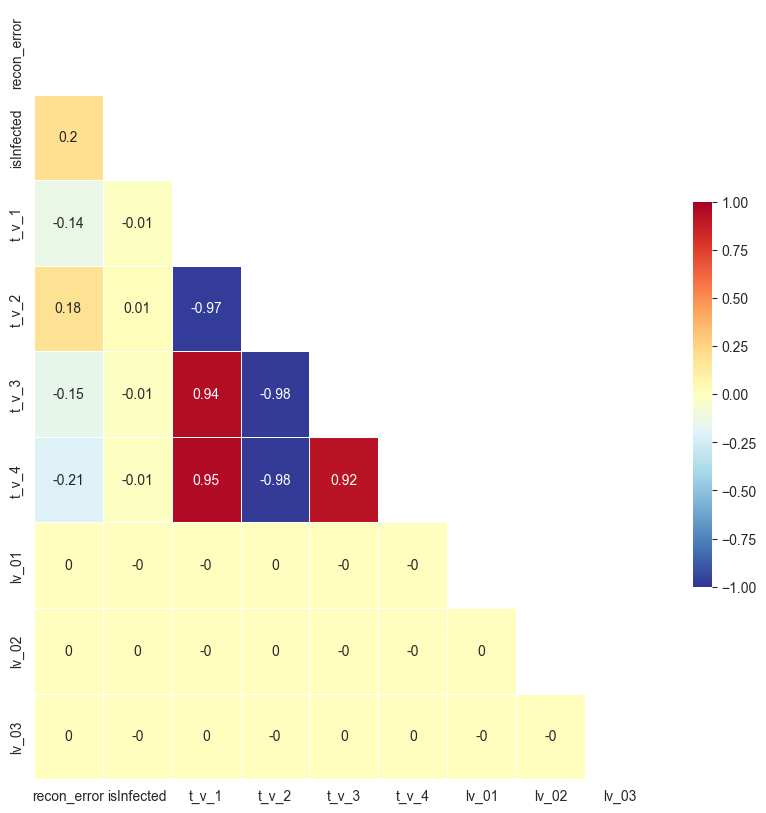

In [18]:
dfdf = np.round(corrDf.corr(),2)
fig, ax = plt.subplots( figsize=(10,10) )


mask = np.zeros_like(dfdf, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# 히트맵을 그린다
sns.heatmap(dfdf, 
            cmap = 'RdYlBu_r', 
            annot = True,   
            mask=mask,      
            linewidths=.5,  
            cbar_kws={"shrink": .5},
            vmin = -1,vmax = 1   
           )  
plt.show()

#### projections

In [10]:
rawDf[['recon_error','t_v_2','lv_01','isInfected']]

,recon_error,t_v_2,lv_01,isInfected
0,9.609886,0.258644,0.311383,0.0
1,9.621607,0.258186,0.624603,0.0
2,5.151839,0.258228,0.320820,0.0
3,9.900413,0.258053,0.575350,0.0
4,6.031685,0.258567,0.512276,0.0
...,...,...,...,...
116756,6.872757,0.258018,0.715528,0.0
116757,3.041865,0.257381,0.295825,0.0
116758,3.684286,0.258543,0.475797,0.0
116759,10.689089,0.257948,0.736639,0.0


In [11]:
from sklearn.preprocessing import StandardScaler
X_columned = list(zip(rawDf.recon_error,rawDf.t_v_2, rawDf.lv_01))


X_columned = StandardScaler().fit(X_columned).transform(X_columned)
X_columned
len(X_columned)

array([[ 0.97106777,  0.37475337, -1.7395907 ],
       [ 0.97441536,  0.27901681,  1.15355502],
       [-0.30221658,  0.28779494, -1.65242875],
       ...,
       [-0.72137129,  0.35371202, -0.22093862],
       [ 1.27930403,  0.22916596,  2.18840026],
       [-0.57085877, -0.5133909 ,  0.58651198]])

116761

In [25]:
from sklearn.manifold import TSNE

# t-SNE 모델 생성 및 학습
tsneV = TSNE(n_components=3, random_state=0, verbose=1, perplexity=100, n_iter=250)
tsne_V_data = tsneV.fit_transform(X_columned)

/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 116761 samples in 0.036s...
[t-SNE] Computed neighbors for 116761 samples in 6.240s...
[t-SNE] Computed conditional probabilities for sample 1000 / 116761
[t-SNE] Computed conditional probabilities for sample 2000 / 116761
[t-SNE] Computed conditional probabilities for sample 3000 / 116761
[t-SNE] Computed conditional probabilities for sample 4000 / 116761
[t-SNE] Computed conditional probabilities for sample 5000 / 116761
[t-SNE] Computed conditional probabilities for sample 6000 / 116761
[t-SNE] Computed conditional probabilities for sample 7000 / 116761
[t-SNE] Computed conditional probabilities for sample 8000 / 116761
[t-SNE] Computed conditional probabilities for sample 9000 / 116761
[t-SNE] Computed conditional probabilities for sample 10000 / 116761
[t-SNE] Computed conditional probabilities for sample 11000 / 116761
[t-SNE] Computed conditional probabilities for sample 12000 / 116761
[t-SNE] Computed conditional probab

In [28]:
infIndex = rawDf[(rawDf.isInfected == 1.) & (rawDf.recon_error >= 10.)].index.to_list()

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'normal')

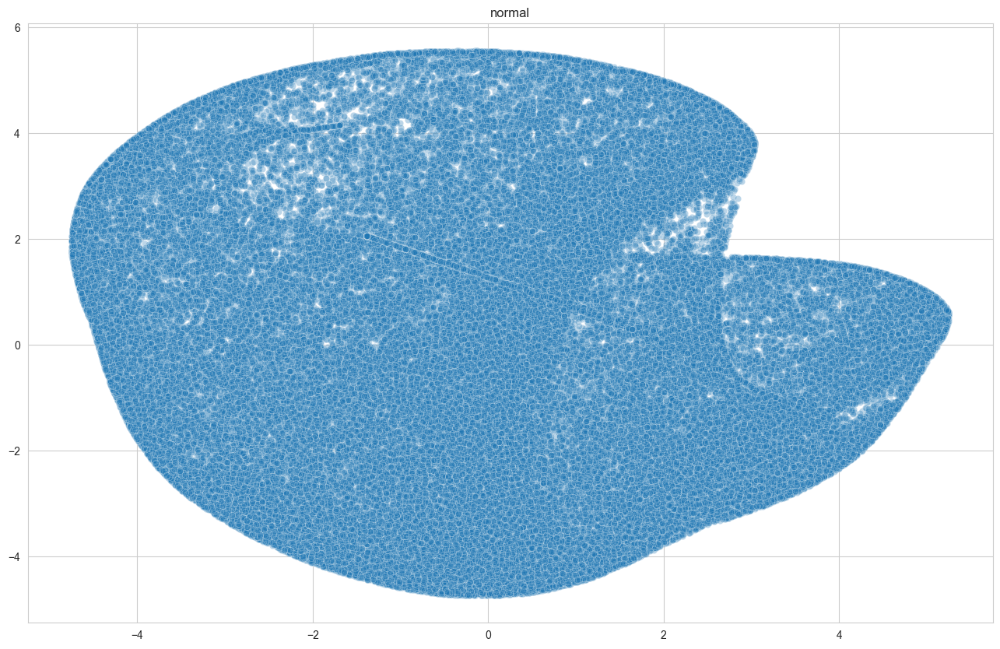

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'abnormal')

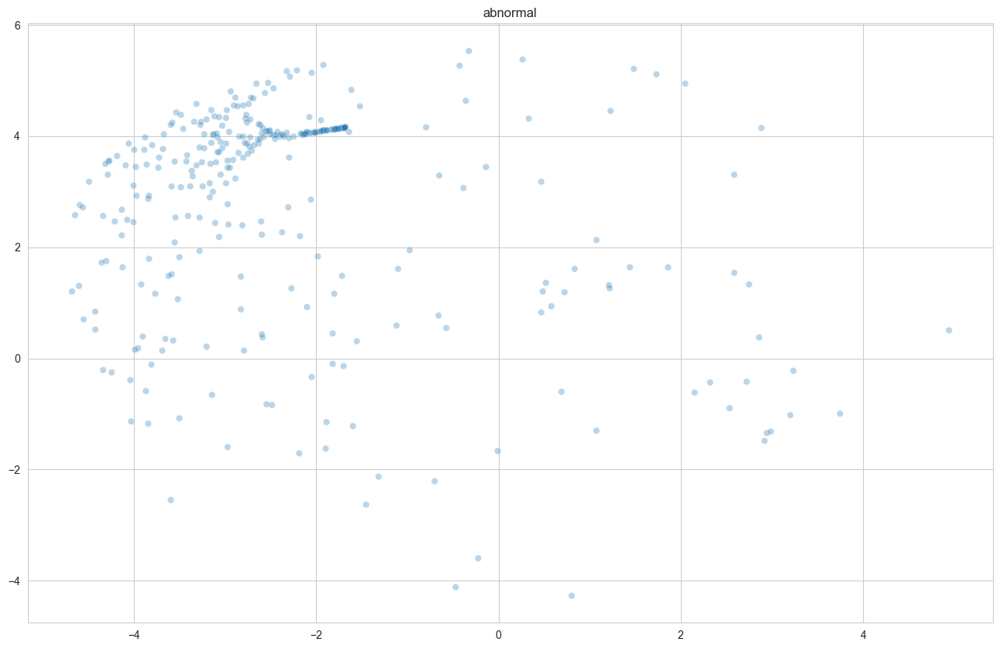

<Figure size 1600x1000 with 0 Axes>

<AxesSubplot: >

/var/folders/v0/dn_8jzmd0396fq71hnvs0rc80000gn/T/ipykernel_14025/1786685282.py:55: MatplotlibDeprecationWarning: Passing argument *p* of unexpected type Line2D to add_patch which only accepts <class 'matplotlib.patches.Patch'> is deprecated since 3.5 and will become an error two minor releases later.
  ax.add_patch(line1)


Text(0.5, 1.0, 'all')

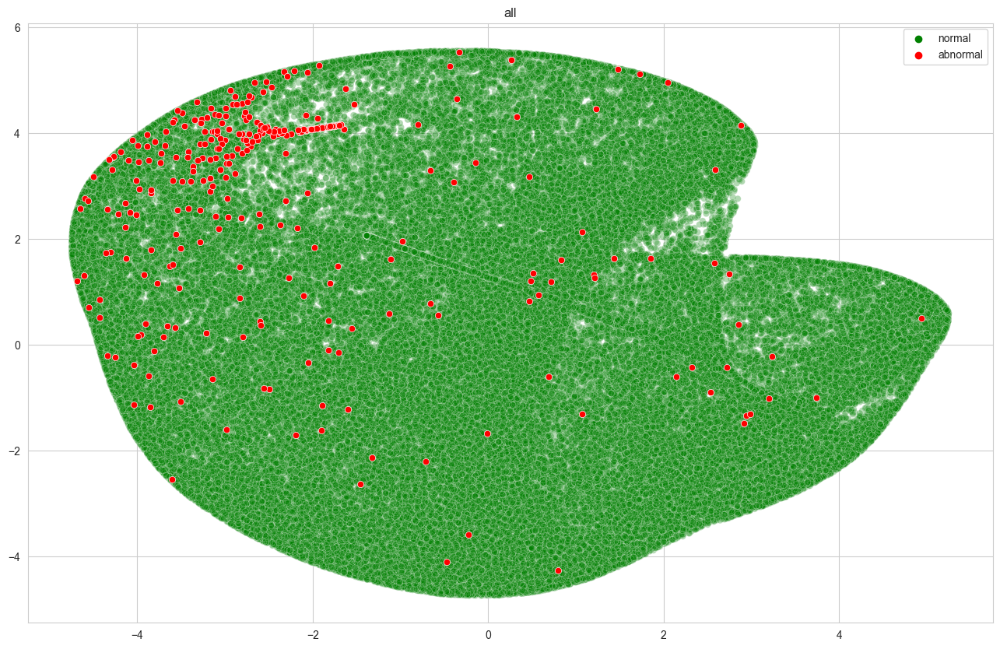

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
# circle1 = plt.Circle(xy=(0, 0), radius=53, color='red', fill=False)
ax = sns.scatterplot(
    x=tsne_V_data[normal_index,0], y=tsne_V_data[normal_index,1],
    # palette=sns.color_palette("hls", 2),hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("normal")
plt.show() 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
# circle1 = plt.Circle(xy=(0, 0), radius=53, color='red', fill=False)
ax = sns.scatterplot(
    x=tsne_V_data[abnormal_index,0], y=tsne_V_data[abnormal_index,1],
    # palette=sns.color_palette("hls", 2),hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("abnormal")
plt.show() 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=tsne_V_data[:,0], y=tsne_V_data[:,1],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

sns.scatterplot(
    x=tsne_V_data[infIndex,0], y=tsne_V_data[infIndex,1],
    color='red',
    legend="full"
)

xx, yy = [6.5,6.5,8.], [8,2,2]
from matplotlib.lines import Line2D
line1 = Line2D(xx,yy)
# ax.add_patch(circle1)
ax.add_patch(line1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 




In [35]:
px_plot_df = pd.DataFrame({'col_x' : tsne_V_data[infIndex,0], 
                           'col_y' : tsne_V_data[infIndex,1], 
                           'col_z' : tsne_V_data[infIndex,2], 
                           'cat' : rawDf.iloc[infIndex,:].isInfected})
px_plot_df['point_size'] = px_plot_df.cat * 20 + 1.
px_plot_df.head(2)

color_plot = np.where(px_plot_df['cat'] == 1., 'red','green').tolist()

,col_x,col_y,col_z,cat,point_size
732,0.326800,-4.257763,-0.063120,1.0,21.0
757,0.360064,-4.275064,-0.097633,1.0,21.0


In [1]:
import plotly.express as px

fig = px.scatter_3d(px_plot_df, x='col_x', y='col_y', z='col_z',
                    color=color_plot, size='point_size', color_discrete_map="identity",
                    title="3D Scatter Plot")
fig.update_traces(marker_size = 1)
# fig.show()

NameError: name 'px_plot_df' is not defined

In [39]:
import plotly.express as px
px_plot_df = pd.DataFrame({'col_x' : tsne_V_data[:,0], 
                           'col_y' : tsne_V_data[:,1], 
                           'col_z' : tsne_V_data[:,2], 
                           'cat' : rawDf.isInfected})
px_plot_df['point_size'] = px_plot_df.cat * 20 + 1.
px_plot_df.head(2)

color_plot = np.where(px_plot_df['cat'] == 1., 'red','green').tolist()
fig = px.scatter_3d(px_plot_df, x='col_x', y='col_y', z='col_z',
                    color=color_plot, size='point_size', color_discrete_map="identity",
                    title="3D Scatter Plot")
# fig.update_traces(marker_size = 1)
fig.show()

,col_x,col_y,col_z,cat,point_size
0,-1.189935,1.039734,3.200174,0.0,1.0
1,1.442103,-0.713825,1.447447,0.0,1.0


#### radius setting

In [141]:
cRadius = 3.4

<Figure size 1000x700 with 0 Axes>

Text(0.5, 1.0, 'all')

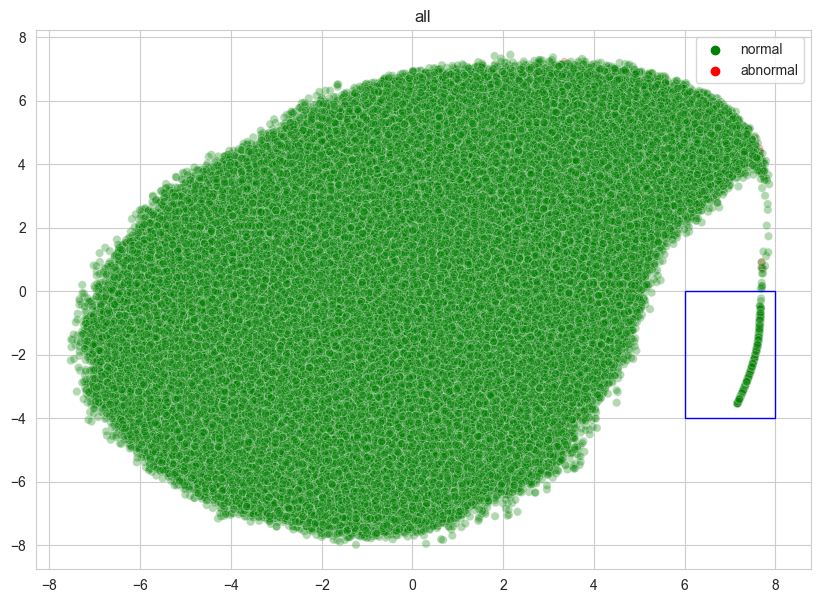

In [32]:
sns.set_style('whitegrid')
plt.figure(figsize=(10,7))
ax = sns.scatterplot(
    x=digits_tsne_test[:,0], y=digits_tsne_test[:,1],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)
# circle1 = plt.Circle(xy=(-.75, -.4), radius=cRadius, color='blue', fill=False)
rect = plt.Rectangle(xy=(6, -4), width=2, height=4, color='blue', fill=False)
ax.add_patch(rect)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 

In [40]:
def isOut(x) : 
    return x[0] > 6. and x[1] < 0

644

In [45]:


rawDf['tsneClass'] = np.where((digits_tsne_test[:,0] > 6) & (digits_tsne_test[:,1] < 0), 1, 0).tolist()

In [112]:
with open('./rawDfTsne.pickle','bw') as f : 
    pickle.dump(rawDf, f)

In [46]:
rawDf[rawDf.tsneClass == 1]

,fileName,recon_error,t_v,lv,isInfected,createTime,tsneClass
26,FA0004_GW01_H01_0202_20211108000647_farm_mic_s...,64.027863,"[[-0.85215294, 0.13880162, 0.3484791, 0.364872...","[0.44916108, 0.44119212, 0.62307, 0.3920566, 0...",0.0,2021-11-08 00:06:47,1
33,FA0004_GW01_H01_0202_20211108000647_farm_mic_s...,59.917843,"[[-0.8521312, 0.13868043, 0.34853438, 0.364916...","[0.47848764, 0.4564945, 0.48851514, 0.5842793,...",0.0,2021-11-08 00:06:47,1
709,FA0004_GW01_H01_0202_20211108010645_farm_mic_s...,67.401329,"[[-0.8521566, 0.13881952, 0.34849843, 0.364838...","[0.34162715, 0.43581817, 0.3724405, 0.44053832...",0.0,2021-11-08 01:06:45,1
736,FA0004_GW01_H01_0202_20211108010645_farm_mic_s...,63.585381,"[[-0.85212016, 0.13861866, 0.34856498, 0.36493...","[0.41297254, 0.479553, 0.4914412, 0.43403578, ...",0.0,2021-11-08 01:06:45,1
738,FA0004_GW01_H01_0202_20211108010645_farm_mic_s...,56.883987,"[[-0.85200524, 0.13798685, 0.34877443, 0.36524...","[0.7135391, 0.5394897, 0.4466961, 0.42321137, ...",0.0,2021-11-08 01:06:45,1
...,...,...,...,...,...,...,...
113361,FA0004_GW01_H01_0201_20211109192151_farm_mic_s...,49.232212,"[[-0.85172004, 0.13642581, 0.34933928, 0.36595...","[0.35812435, 0.47644186, 0.3886203, 0.6426334,...",0.0,2021-11-09 19:21:51,1
114028,FA0004_GW01_H01_0201_20211109201649_farm_mic_s...,61.732609,"[[-0.852158, 0.13882874, 0.34847987, 0.3648494]]","[0.51075125, 0.40848497, 0.49006125, 0.6541195...",0.0,2021-11-09 20:16:49,1
114628,FA0004_GW01_H01_0201_20211109210649_farm_mic_s...,61.384579,"[[-0.85215163, 0.13879357, 0.34849137, 0.36486...","[0.42672622, 0.30980584, 0.53220063, 0.3202048...",0.0,2021-11-09 21:06:49,1
115453,FA0004_GW01_H01_0201_20211109221648_farm_mic_s...,60.167049,"[[-0.8521323, 0.13868707, 0.34852877, 0.364916...","[0.4398335, 0.45354566, 0.4552424, 0.4082716, ...",0.0,2021-11-09 22:16:48,1


### tsne outlier image 

In [167]:
rawDf[(rawDf.tsneClass == 1) & ((rawDf.moduleId.str.contains('0200|0201')))]['fileName'].to_csv('./filelistTsneNormal.csv')

In [163]:
rawDf['moduleId'] = [x.split('_')[3] for x in rawDf.fileName]

In [195]:
idx = 3
(audio, samplerate) = librosa.load('../data/ILT/20211108_20211109/FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav', sr=44100)
IPython.display.Audio(data=audio[samplerate*(idx):samplerate*(idx+1)], rate=samplerate)

#### DNS interest regions

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_04.jpg : [7.4790053], [0.]


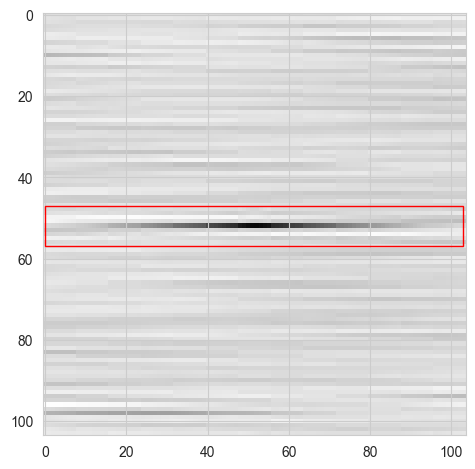

In [205]:
import matplotlib.patches as patches
aName = 'FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_04.jpg'
moduleId = aName.split('_')[3]
aDate = aName.split('_')[4][:8]
if moduleId >= '0202' :
    aFileName = '../output/ilt_20211108_20211109/abnormal/' + aName
else : 
    aFileName = '../output/ilt_20211108_20211109/normal/' + aDate + '/' + aName

print(f"{aName} : {rawDf[rawDf.fileName == aName]['recon_error'].values}, {rawDf[rawDf.fileName == aName]['isInfected'].values}")
aImg = plt.imread(aFileName)
fig, ax = plt.subplots()
ax.imshow(aImg)
rect = patches.Rectangle((0, 47), 103, 10, linewidth=1, edgecolor='r', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)
# plt.axis('off')
plt.grid(visible=True)
plt.tight_layout()
plt.show()

10980

FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708.wav
FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708_32.jpg : [7.307412], [0.]


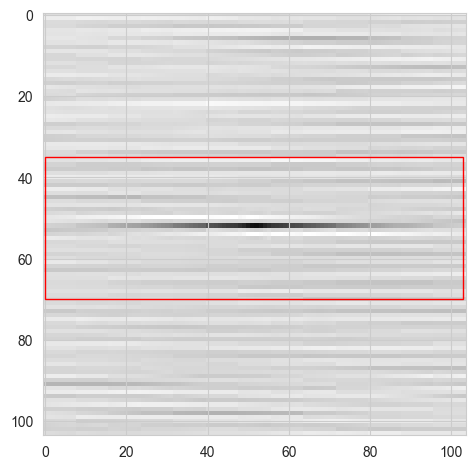

FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708.wav
FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708_38.jpg : [6.9667144], [0.]


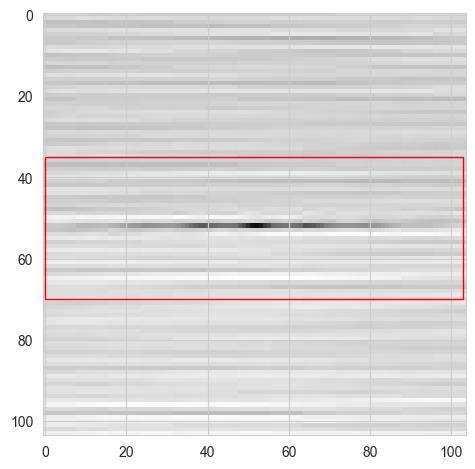

FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708.wav
FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708_40.jpg : [4.433475], [0.]


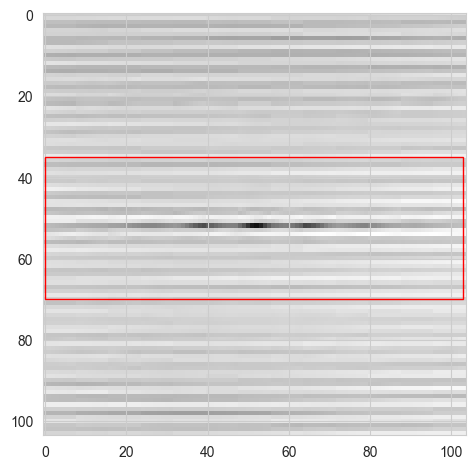

FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708.wav
FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708_41.jpg : [6.8168683], [0.]


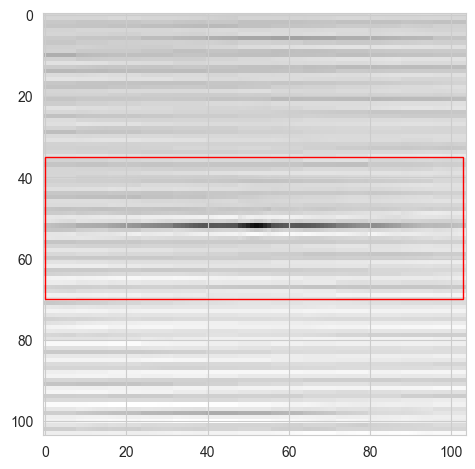

FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708.wav
FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708_47.jpg : [4.676668], [0.]


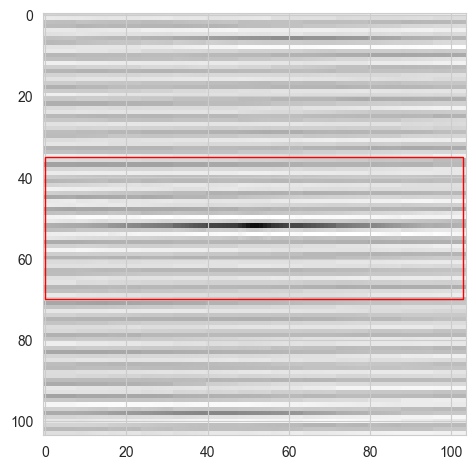

FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708.wav
FA0004_GW01_H01_0200_20211108012145_farm_mic_snd_7953da864708_50.jpg : [3.568756], [0.]


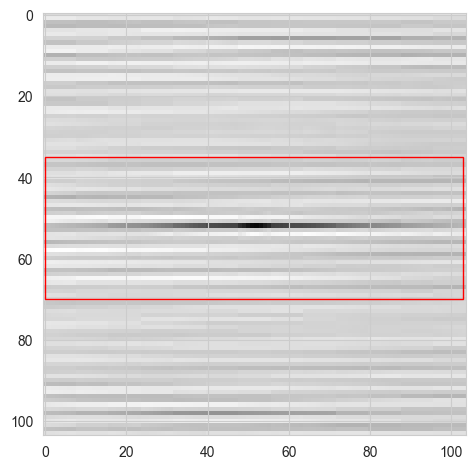

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_01.jpg : [5.455612], [0.]


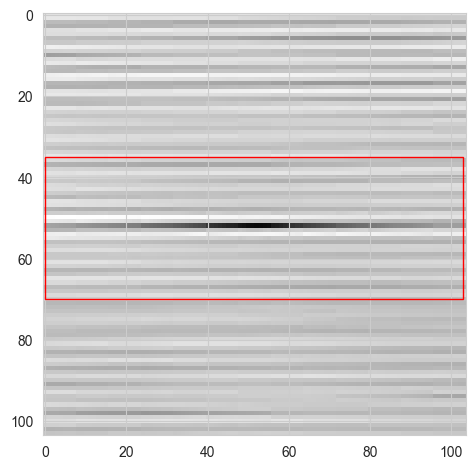

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_13.jpg : [6.934541], [0.]


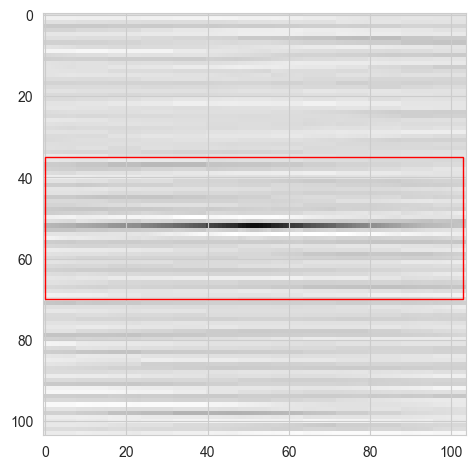

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_15.jpg : [4.688332], [0.]


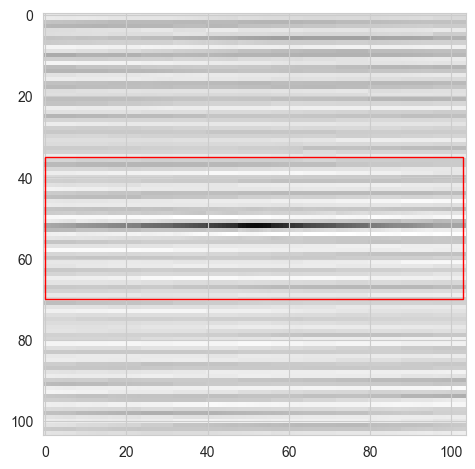

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_24.jpg : [7.7160378], [0.]


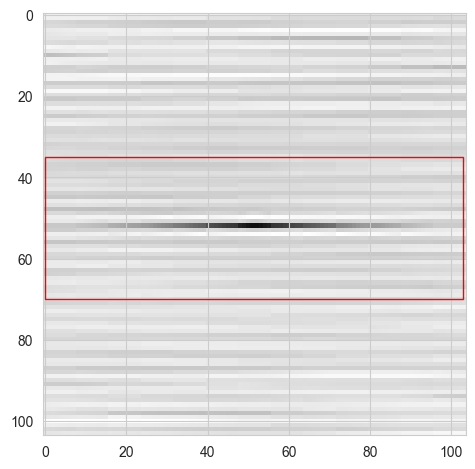

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_26.jpg : [5.0812845], [0.]


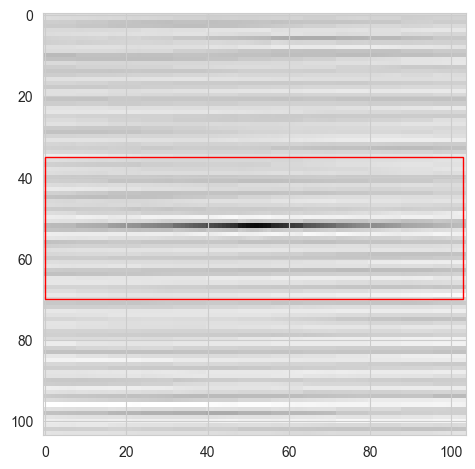

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_30.jpg : [6.6363053], [0.]


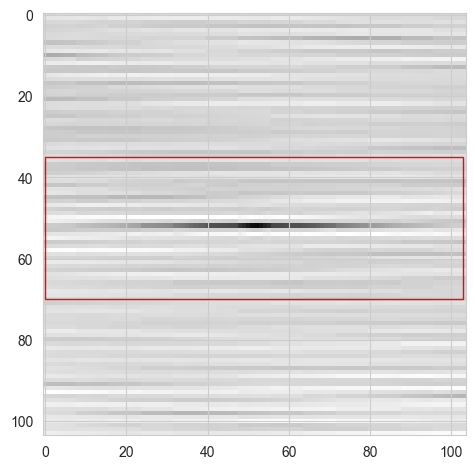

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_31.jpg : [4.185206], [0.]


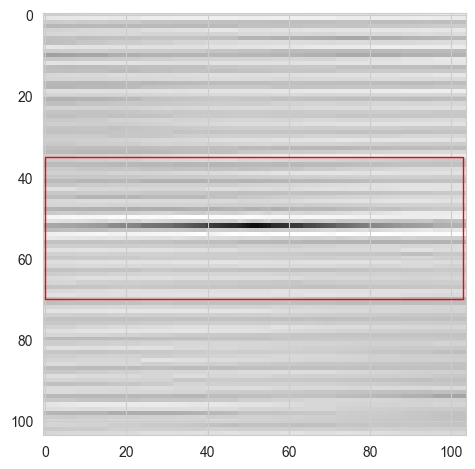

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_32.jpg : [5.200446], [0.]


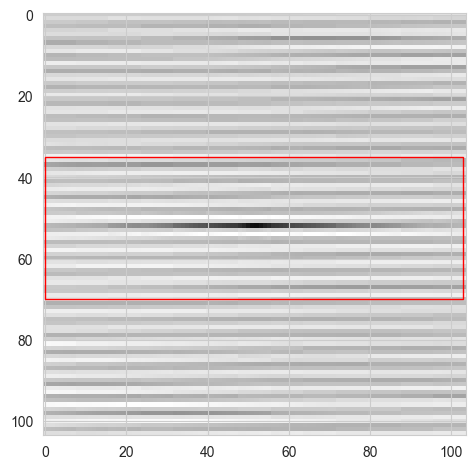

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_39.jpg : [6.566331], [0.]


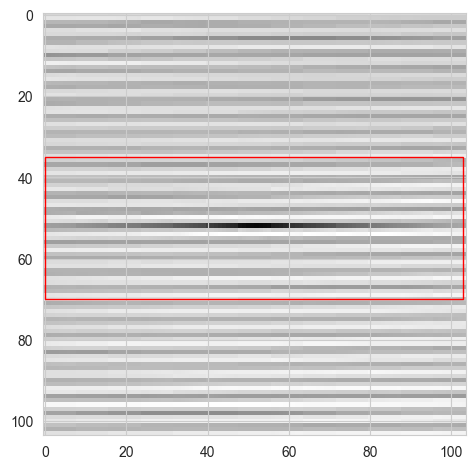

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_46.jpg : [6.0011864], [0.]


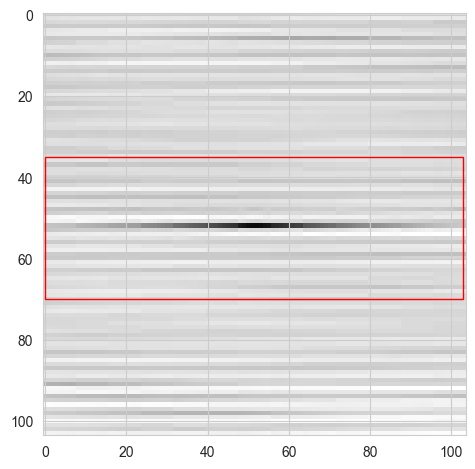

FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8.wav
FA0004_GW01_H01_0200_20211108012646_farm_mic_snd_39dbdcf44cc8_56.jpg : [6.418569], [0.]


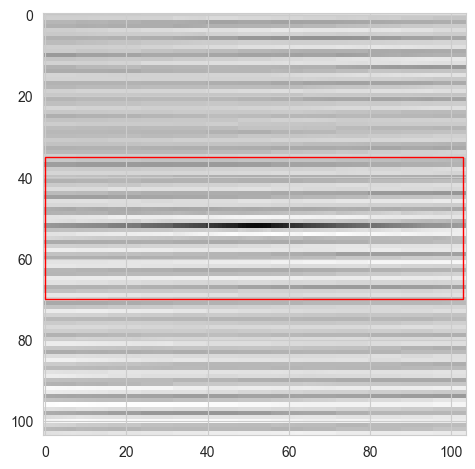

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_04.jpg : [4.686579], [0.]


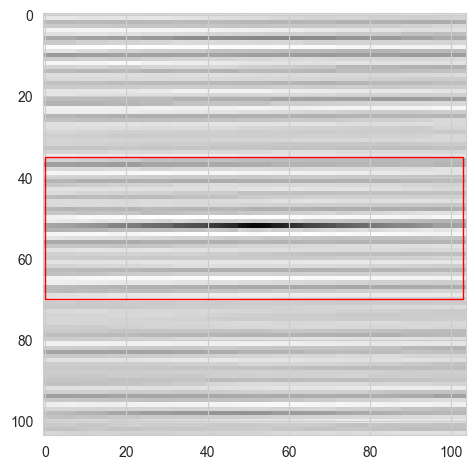

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_12.jpg : [4.9050374], [0.]


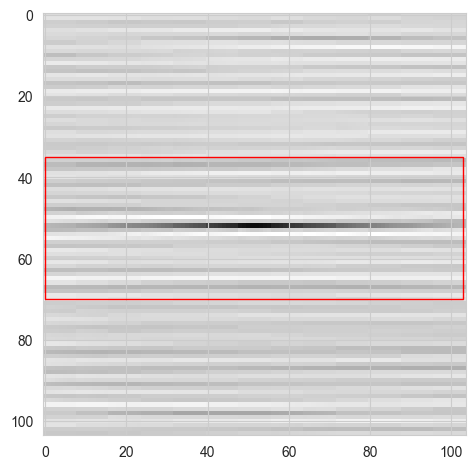

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_21.jpg : [5.258379], [0.]


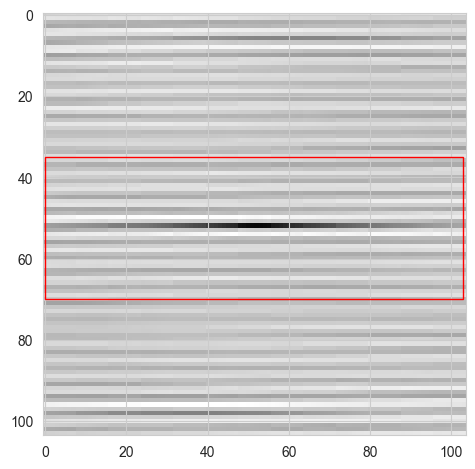

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_43.jpg : [5.422266], [0.]


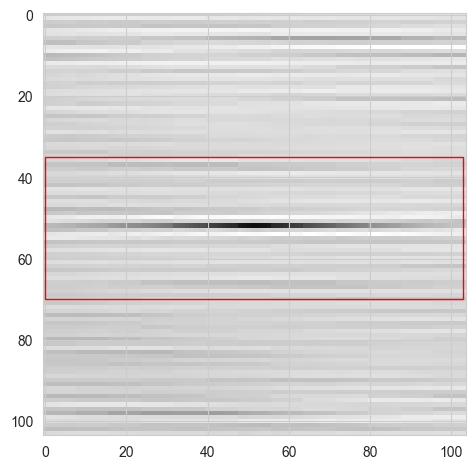

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_45.jpg : [4.331738], [0.]


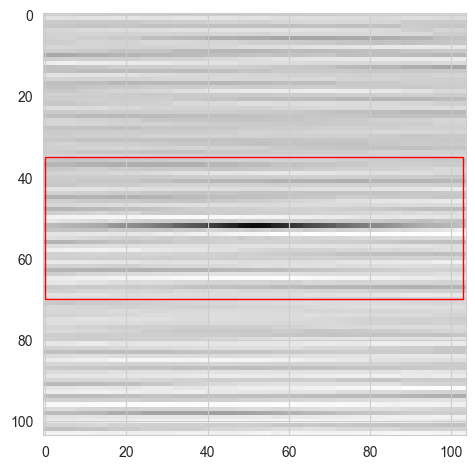

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_48.jpg : [4.715496], [0.]


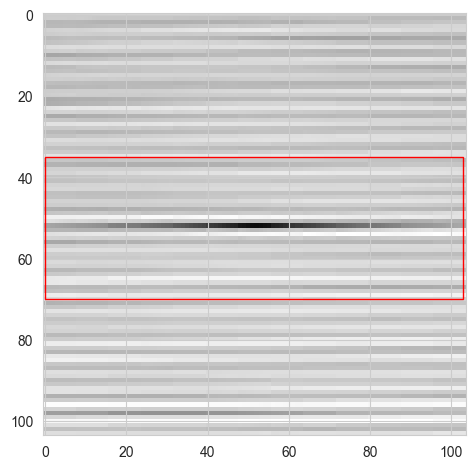

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_50.jpg : [6.6134443], [0.]


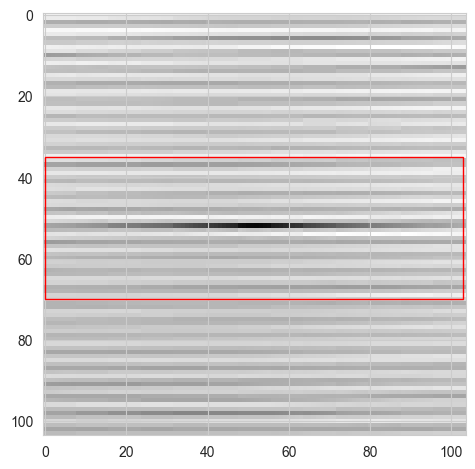

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_52.jpg : [5.691432], [0.]


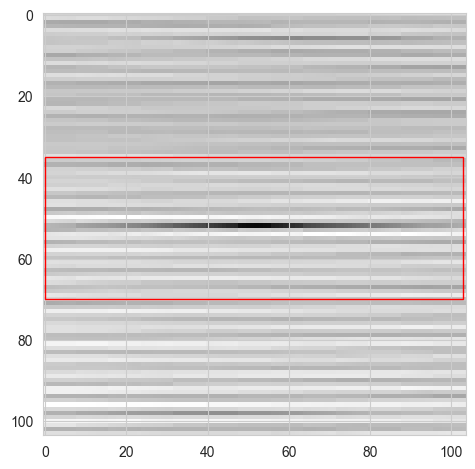

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_55.jpg : [5.5112433], [0.]


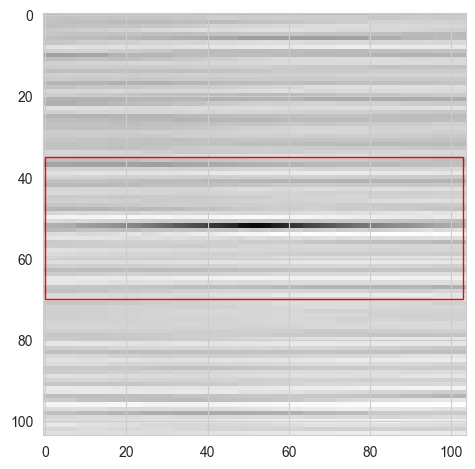

FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b.wav
FA0004_GW01_H01_0200_20211108013147_farm_mic_snd_ad3bd630429b_56.jpg : [4.8996954], [0.]


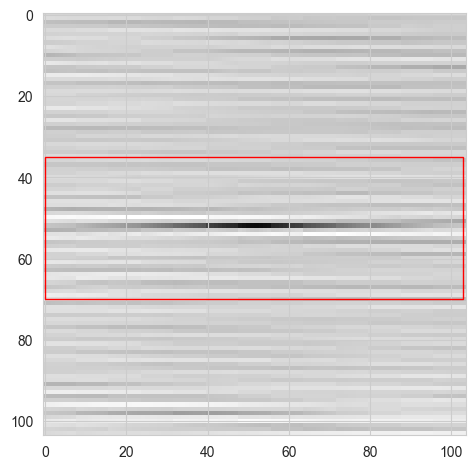

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_01.jpg : [4.3243012], [0.]


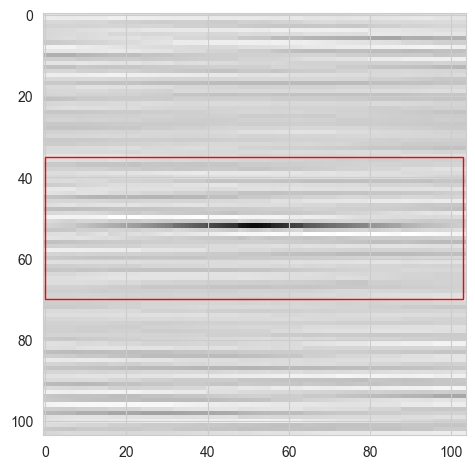

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_02.jpg : [4.4541845], [0.]


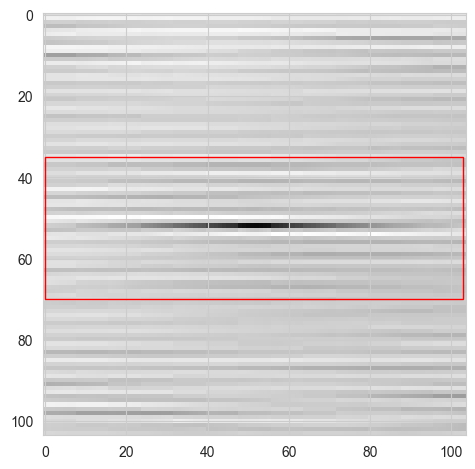

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_03.jpg : [24.580233], [0.]


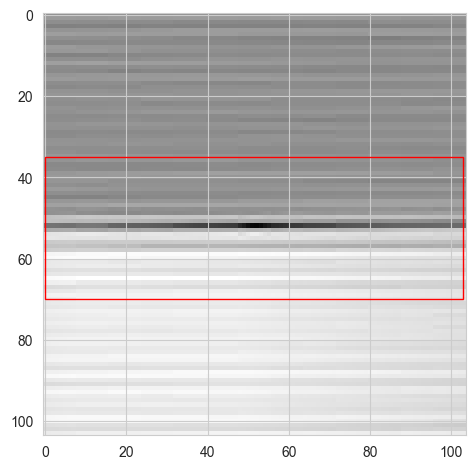

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_04.jpg : [7.4790053], [0.]


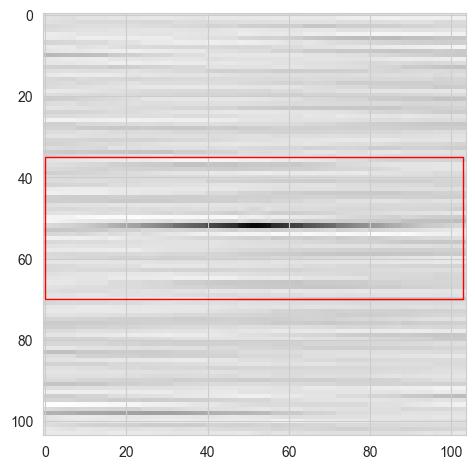

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_05.jpg : [5.509991], [0.]


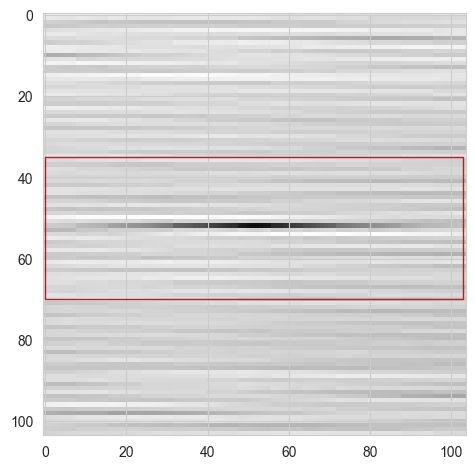

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_06.jpg : [6.262621], [0.]


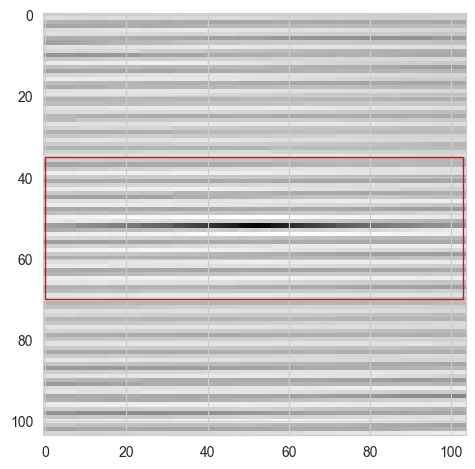

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_29.jpg : [6.7948465], [0.]


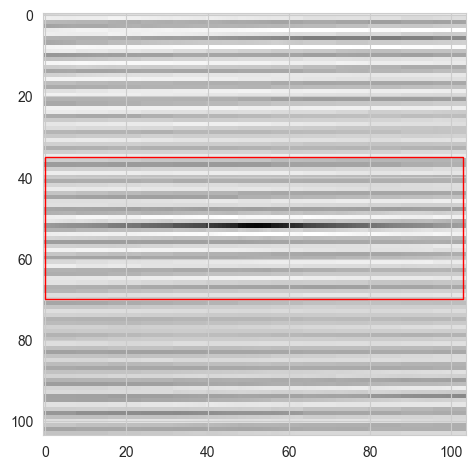

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_41.jpg : [6.664484], [0.]


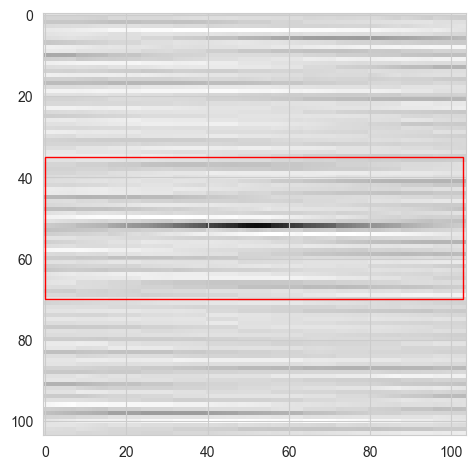

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_48.jpg : [4.447332], [0.]


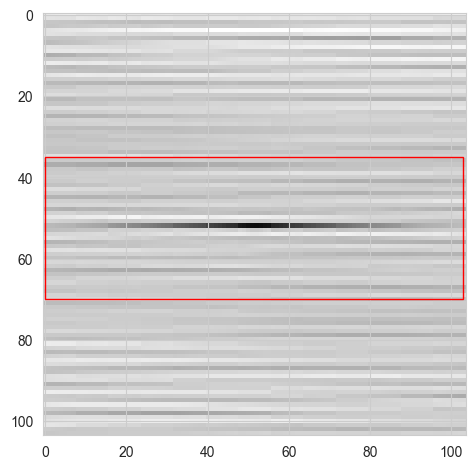

FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2.wav
FA0004_GW01_H01_0200_20211108013646_farm_mic_snd_a2fe2cea4eb2_55.jpg : [7.853967], [0.]


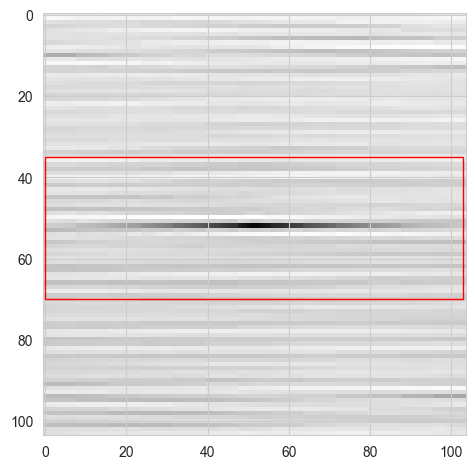

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_05.jpg : [8.056819], [0.]


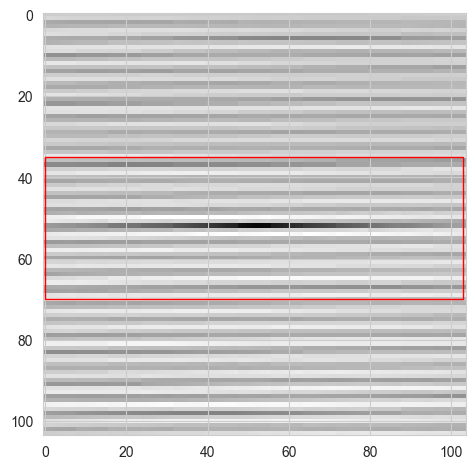

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_07.jpg : [5.2795353], [0.]


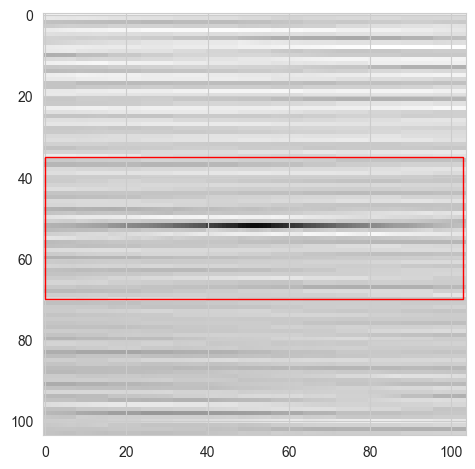

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_10.jpg : [7.033897], [0.]


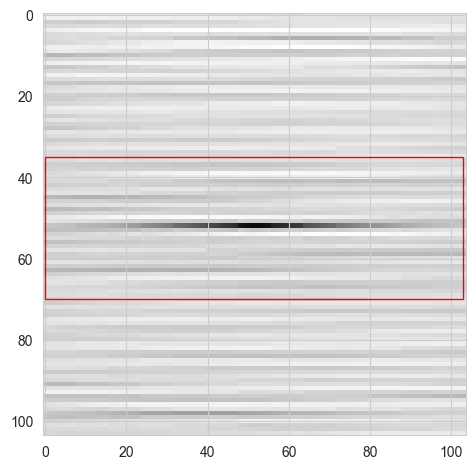

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_11.jpg : [4.649963], [0.]


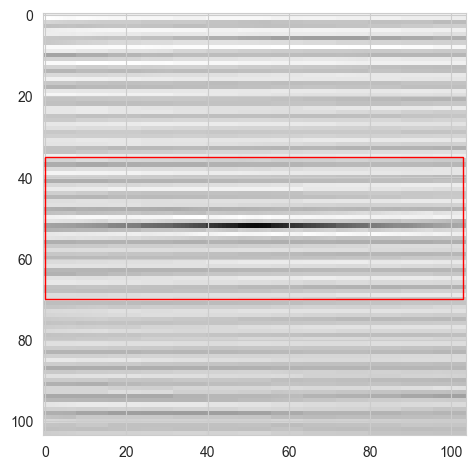

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_26.jpg : [3.5836892], [0.]


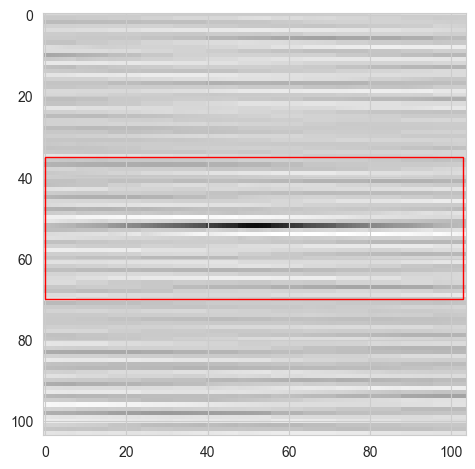

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_28.jpg : [7.5526676], [0.]


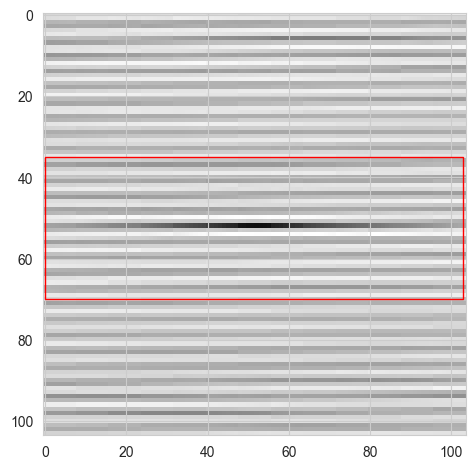

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_29.jpg : [7.81044], [0.]


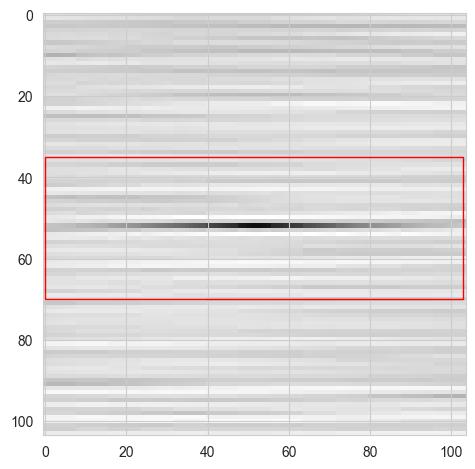

FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347.wav
FA0004_GW01_H01_0200_20211108014146_farm_mic_snd_02dbf8b34347_37.jpg : [4.807134], [0.]


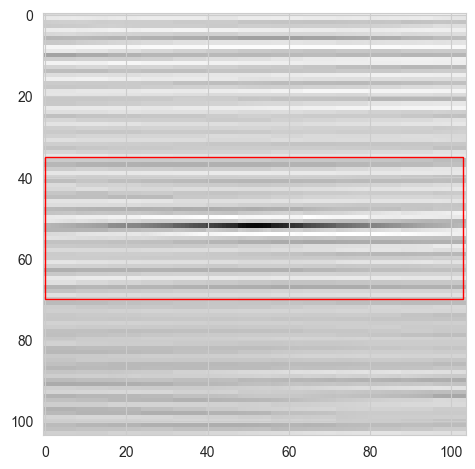

FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d.wav
FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d_07.jpg : [4.9574103], [0.]


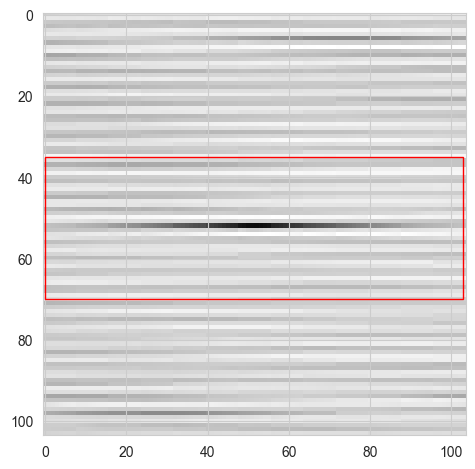

FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d.wav
FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d_09.jpg : [5.6854353], [0.]


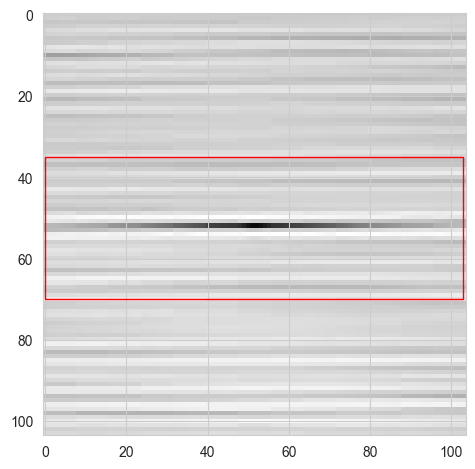

FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d.wav
FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d_15.jpg : [11.3465], [0.]


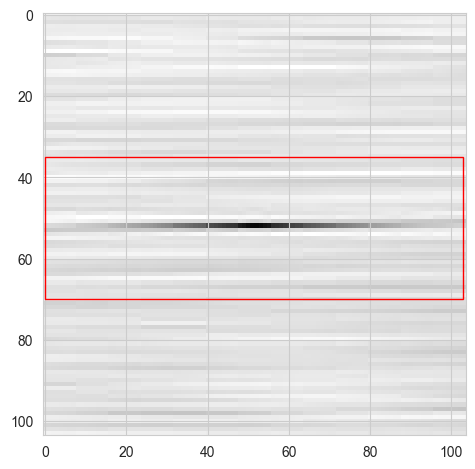

FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d.wav
FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d_22.jpg : [8.830173], [0.]


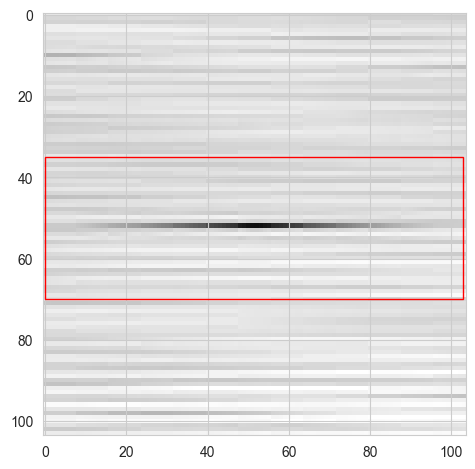

FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d.wav
FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d_24.jpg : [6.1401434], [0.]


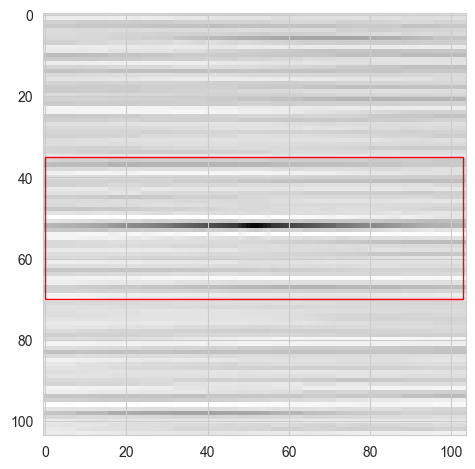

FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d.wav
FA0004_GW01_H01_0200_20211108014645_farm_mic_snd_bfeb7d85417d_30.jpg : [9.55267], [0.]


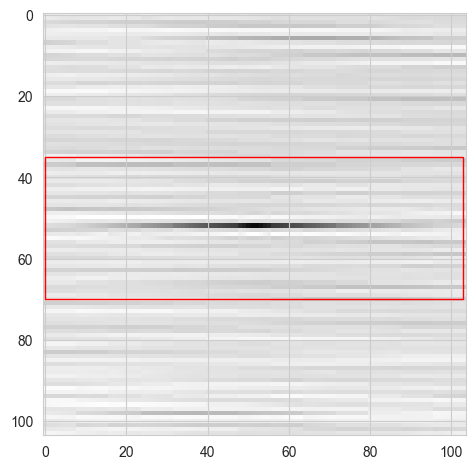

In [197]:
# tsne outlier and class normal
import matplotlib.patches as patches
filelistTsne = rawDf[(rawDf.tsneClass == 1) & ((rawDf.moduleId.str.contains('0200|0201')))]['fileName'].to_list()
len(filelistTsne)
start = 150 
end = min(start+50,len(filelistTsne))
for idx, aName in enumerate(filelistTsne) : 
    if idx < start : continue
    if idx > end : break
    moduleId = aName.split('_')[3]
    aDate = aName.split('_')[4][:8]
    if moduleId >= '0202' :
        aFileName = '../output/ilt_20211108_20211109/abnormal/' + aName
    else : 
        aFileName = '../output/ilt_20211108_20211109/normal/' + aDate + '/' + aName
    print(f"{'_'.join(aName.split('_')[:-1])+'.wav'}")
    print(f"{aName} : {rawDf[rawDf.fileName == aName]['recon_error'].values}, {rawDf[rawDf.fileName == aName]['isInfected'].values}")
    aImg = plt.imread(aFileName)
    fig, ax = plt.subplots()
    ax.imshow(aImg)
    rect = patches.Rectangle((0, 47), 103, 10, linewidth=1, edgecolor='r', facecolor='none')

    # Add the patch to the Axes
    ax.add_patch(rect)
    # plt.axis('off')
    plt.grid(visible=True)
    plt.tight_layout()
    plt.show()

#### no scaler

In [34]:
from sklearn.preprocessing import StandardScaler
X_test_results_test = list(zip(rawDf.recon_error,rawDf.t_v, rawDf.lv))
X_test_results_test = [[x[0], *x[1].flatten(),*x[2].flatten()] for x in X_test_results_test]
#X_test_results_test = [list(x[1].flatten()) for x in X_test_results_test]
# X_test_results_test

# X_test_results_test = StandardScaler().fit(X_test_results_test).transform(X_test_results_test)
X_test_results_test
len(X_test_results_test)

from sklearn.manifold import TSNE

# t-SNE 모델 생성 및 학습
tsne = TSNE(n_components=2, random_state=0, verbose=1, perplexity=100, n_iter=250)
digits_tsne_test = tsne.fit_transform(X_test_results_test)


[[85.64569854736328,
  -0.8524038,
  0.14019267,
  0.34800395,
  0.3642073,
  0.40855324,
  0.46510977,
  0.7097476,
  0.56814486,
  0.316918,
  0.55815744,
  0.64728874,
  0.34012997],
 [81.15434265136719,
  -0.85236317,
  0.13996583,
  0.3480842,
  0.3643131,
  0.27788466,
  0.36511216,
  0.42506468,
  0.5379058,
  0.34429306,
  0.46129566,
  0.3032325,
  0.44387156],
 [82.04432678222656,
  -0.85236794,
  0.13999215,
  0.34807685,
  0.36429885,
  0.56922,
  0.35463578,
  0.6267819,
  0.30983818,
  0.42533126,
  0.50775206,
  0.584127,
  0.37976047],
 [71.48514556884766,
  -0.8522888,
  0.13955297,
  0.34822354,
  0.36451226,
  0.39463955,
  0.67393446,
  0.39146224,
  0.37539956,
  0.5514769,
  0.4738825,
  0.5454048,
  0.47857848],
 [85.93861389160156,
  -0.85240895,
  0.14022088,
  0.34799436,
  0.36419368,
  0.50063163,
  0.7099569,
  0.5955185,
  0.46173003,
  0.49454555,
  0.5418659,
  0.4407194,
  0.6055664],
 [86.88172912597656,
  -0.85241306,
  0.14024371,
  0.34798616,
  0.3

116761

/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/hansgun/.pyenv/versions/3.9.14/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 116761 samples in 0.047s...
[t-SNE] Computed neighbors for 116761 samples in 19.325s...
[t-SNE] Computed conditional probabilities for sample 1000 / 116761
[t-SNE] Computed conditional probabilities for sample 2000 / 116761
[t-SNE] Computed conditional probabilities for sample 3000 / 116761
[t-SNE] Computed conditional probabilities for sample 4000 / 116761
[t-SNE] Computed conditional probabilities for sample 5000 / 116761
[t-SNE] Computed conditional probabilities for sample 6000 / 116761
[t-SNE] Computed conditional probabilities for sample 7000 / 116761
[t-SNE] Computed conditional probabilities for sample 8000 / 116761
[t-SNE] Computed conditional probabilities for sample 9000 / 116761
[t-SNE] Computed conditional probabilities for sample 10000 / 116761
[t-SNE] Computed conditional probabilities for sample 11000 / 116761
[t-SNE] Computed conditional probabilities for sample 12000 / 116761
[t-SNE] Computed conditional proba

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'normal')

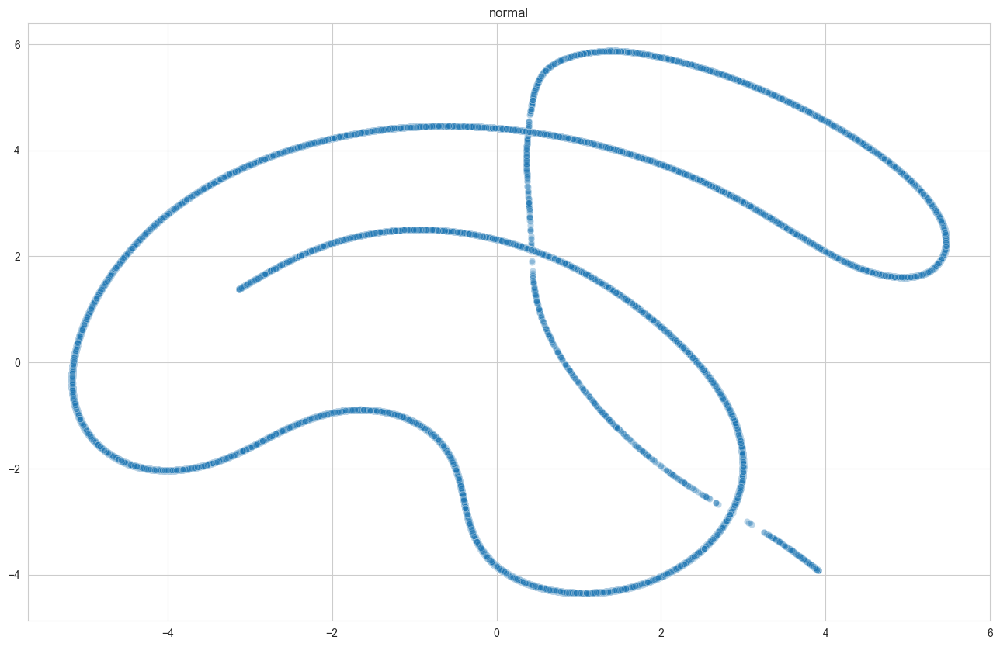

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'abnormal')

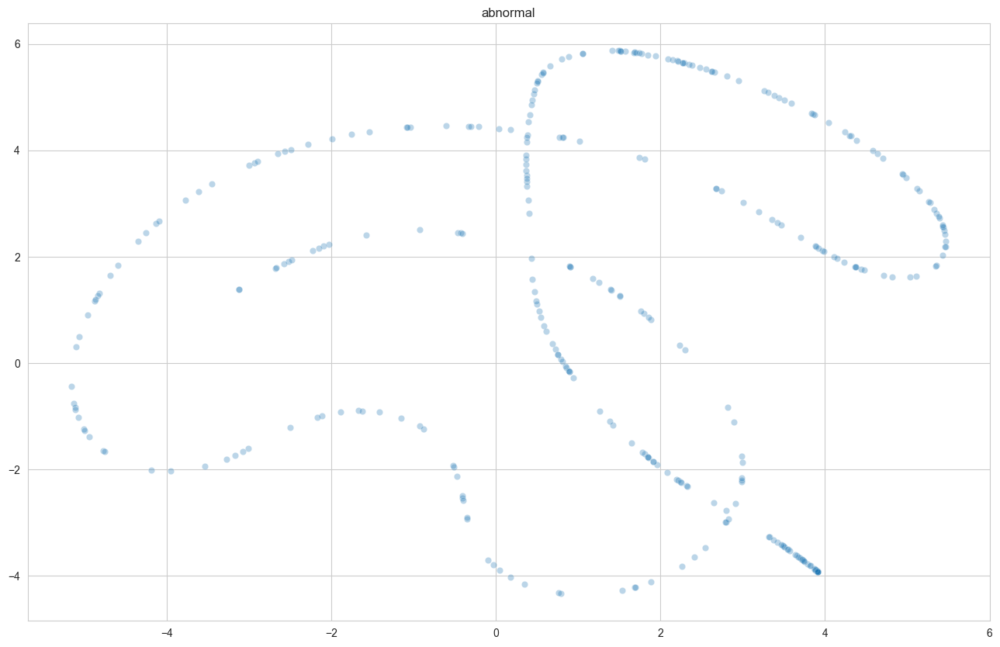

<Figure size 1600x1000 with 0 Axes>

Text(0.5, 1.0, 'all')

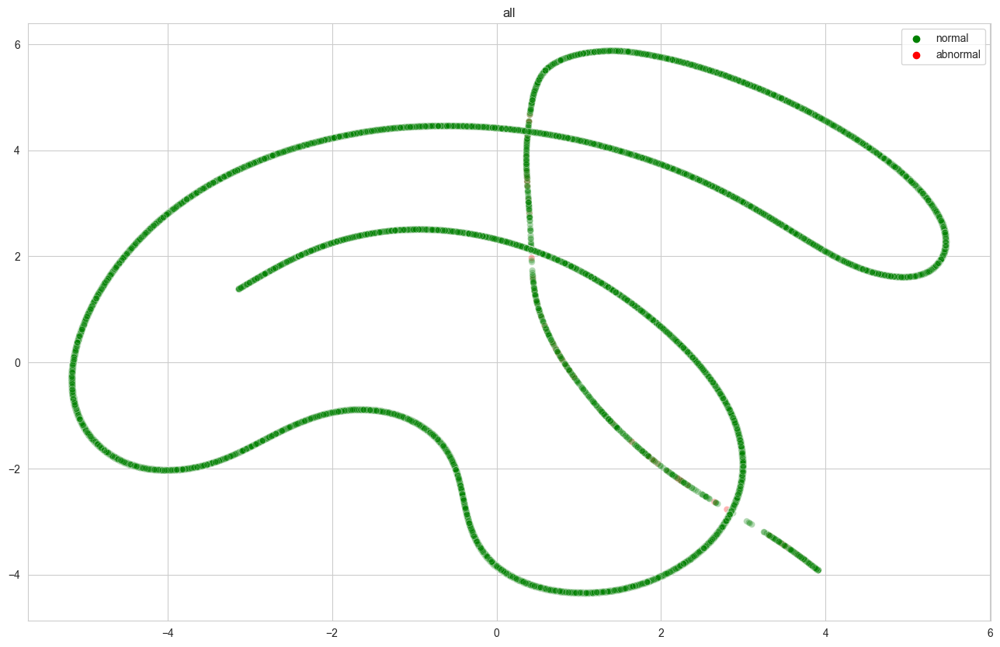

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
# circle1 = plt.Circle(xy=(0, 0), radius=53, color='red', fill=False)
ax = sns.scatterplot(
    x=digits_tsne_test[normal_index,0], y=digits_tsne_test[normal_index,1],
    # palette=sns.color_palette("hls", 2),hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("normal")
plt.show() 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
# circle1 = plt.Circle(xy=(0, 0), radius=53, color='red', fill=False)
ax = sns.scatterplot(
    x=digits_tsne_test[abnormal_index,0], y=digits_tsne_test[abnormal_index,1],
    # palette=sns.color_palette("hls", 2),hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("abnormal")
plt.show() 

plt.figure(figsize=(16,10))
sns.set_style('whitegrid')
ax = sns.scatterplot(
    x=digits_tsne_test[:,0], y=digits_tsne_test[:,1],
    palette=['green','red'],hue=colors_pred_test, 
    legend="full",
    alpha=0.3
)

# ax.add_patch(circle1)
# ax.set(xlim=(-20, 30))
# ax.set(ylim=(-100, 100));
plt.title("all")
plt.show() 


